<a href="https://colab.research.google.com/github/xyaoaf/UrbanTreeStudywithLidar/blob/main/230403_spatialCorrelation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install rasterio

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [2]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
import rasterio
import numpy as np
import matplotlib.pyplot as plt
import os
import pandas as pd
from rasterio.plot import show
import seaborn as sns
# set the maximum number of columns to display to 30
pd.set_option('display.max_columns', 80)
from sklearn.linear_model import LinearRegression

In [4]:
e_folder_30 = "/content/drive/MyDrive/XihanYAO_GISDataShare/230402_East30StatisticsLayers"
e_folder_2 = "/content/drive/MyDrive/XihanYAO_GISDataShare/230402_East2StatisticsLayers"
w_folder_30 = "/content/drive/MyDrive/XihanYAO_GISDataShare/230402_West30StatisticsLayers"
w_folder_2 = "/content/drive/MyDrive/XihanYAO_GISDataShare/230402_West2StatisticsLayers"
lstpath = "/content/drive/MyDrive/XihanYAO_GISDataShare/230102_CityScaleAnalysis(LST,NDVI,GNDVI,EVI,SAVI,VegUmixing,NDBI,NDWI)/landsatImageStack2019-08-05_230109.tif"

# lst

In [5]:
lst = rasterio.open(lstpath)
crs = lst.crs
print (crs)
# Get the names of all bands
band_names = lst.descriptions
# Print the names of all bands
print(band_names)

EPSG:32610
('LST', 'distance', 'ndviLandsat', 'gndviLandsat', 'eviLandsat', 'saviLandsat', 'unmixingVegLandsat', 'ndmiLandsat', 'mndwiLandsat', 'tasseledGreenness')


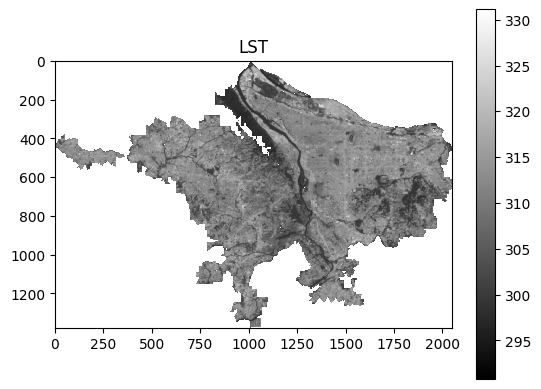

In [6]:
# Display the raster
fig, ax = plt.subplots()
lst_band = lst.read(1)
im = ax.imshow(lst.read(1), cmap='gray', interpolation='none')
ax.set_title("LST")
fig.colorbar(im, ax=ax)
plt.show()

# West Area

In [7]:
file_path = w_folder_30 + "/area.tif"
src = rasterio.open(file_path)

Raster shape: (35, 31)
Raster CRS: EPSG:32610
Raster extent: BoundingBox(left=526620.0, bottom=5042880.0, right=527550.0, top=5043930.0)


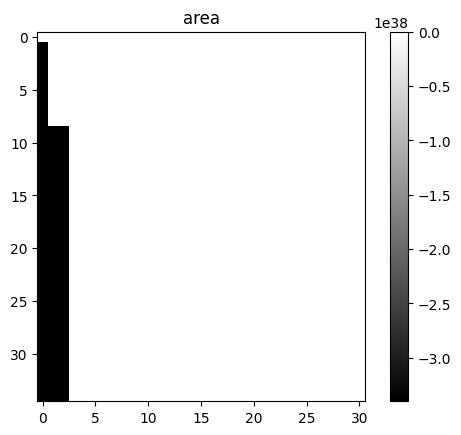

In [8]:
# Read the first band (layer) of the raster
band = src.read(1)

# Get the 5th and 95th percentiles of the pixel values
p5, p95 = np.percentile(band, (5, 95))

# Get the file name without the extension
file_name = os.path.splitext(os.path.basename(file_path))[0]

# Get some information about the raster
print(f"Raster shape: {src.shape}")
print(f"Raster CRS: {src.crs}")
print(f"Raster extent: {src.bounds}")

# Display the raster
fig, ax = plt.subplots()
im = ax.imshow(band, cmap='gray', vmin=p5, vmax=p95, interpolation='none')
ax.set_title(file_name)
fig.colorbar(im, ax=ax)
plt.show()

Raster shape: (35, 31)
Raster CRS: EPSG:32610
Raster extent: BoundingBox(left=526620.0, bottom=5042880.0, right=527550.0, top=5043930.0)


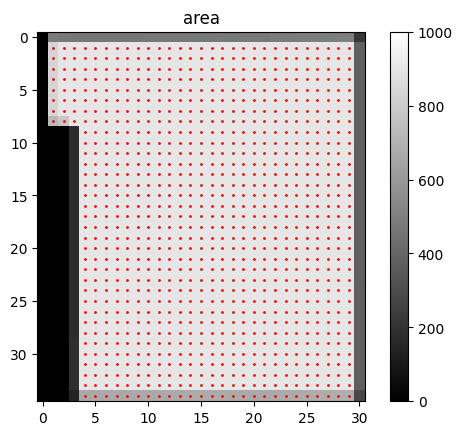

      x   y       lon        lat
0     1   1  526665.0  5043885.0
1     2   1  526695.0  5043885.0
2     3   1  526725.0  5043885.0
3     4   1  526755.0  5043885.0
4     5   1  526785.0  5043885.0
..   ..  ..       ...        ...
903  25  34  527385.0  5042895.0
904  26  34  527415.0  5042895.0
905  27  34  527445.0  5042895.0
906  28  34  527475.0  5042895.0
907  29  34  527505.0  5042895.0

[908 rows x 4 columns]


In [9]:
# Get the geospatial coordinates of the center of each pixel
indices = np.where(band > 600)
x, y = rasterio.transform.xy(src.transform, indices[0], indices[1], offset='center')

# Create a DataFrame with the pixel coordinates and geospatial coordinates
df = pd.DataFrame({'x': indices[1], 'y': indices[0], 'lon': x, 'lat': y})

# Get the file name without the extension
file_name = os.path.splitext(os.path.basename(file_path))[0]

# Get some information about the raster
print(f"Raster shape: {src.shape}")
print(f"Raster CRS: {src.crs}")
print(f"Raster extent: {src.bounds}")

# Display the raster
fig, ax = plt.subplots()
im = ax.imshow(band, cmap='gray', vmin=0, vmax=1000, interpolation='none')
ax.set_title(file_name)
fig.colorbar(im, ax=ax)

# Plot the coordinates of the selected pixels as red dots
ax.plot(df['x'], df['y'], 'ro', markersize=1)

plt.show()

# Print the DataFrame with the pixel and geospatial coordinates
print(df)

In [10]:
# # Define a function to extract the raster value at a given point
# def extract_raster_value(number, point, src):
#     x, y = point['lon'], point['lat']
#     row, col = src.read(number).index(x, y)
#     return src.read(number, window=((row, row+1), (col, col+1)))[0][0]

In [11]:
# Extract raster values at coordinates
values0 = []
values2 = []
values3 = []
values4 = []
values5 = []
values6 = []
values7 = []
values8 = []
values9 = []
for index, row in df.iterrows():
    x, y = row['lon'], row['lat']
    value0 = next(lst.sample([(x, y)]))[0]
    values0.append(value0)
    value2 = next(lst.sample([(x, y)]))[2]
    values2.append(value2)
    value3 = next(lst.sample([(x, y)]))[3]
    values3.append(value3)
    value4 = next(lst.sample([(x, y)]))[4]
    values4.append(value4)
    value5 = next(lst.sample([(x, y)]))[5]
    values5.append(value5)
    value6 = next(lst.sample([(x, y)]))[6]
    values6.append(value6)
    value7 = next(lst.sample([(x, y)]))[7]
    values7.append(value7)
    value8 = next(lst.sample([(x, y)]))[8]
    values8.append(value8)
    value9 = next(lst.sample([(x, y)]))[9]
    values9.append(value9)

# Add raster values as a new column in the dataframe
df['LST'] = values0
df['ndviLandsat'] = values2
df['gndviLandsat'] = values3
df['eviLandsat'] = values4
df['saviLandsat'] = values5
df['unmixingVegLandsat'] = values6
df['ndmiLandsat'] = values7
df['mndwiLandsat'] = values8
df['tasseledGreenness'] = values9
df

,x,y,lon,lat,LST,ndviLandsat,gndviLandsat,eviLandsat,saviLandsat,unmixingVegLandsat,ndmiLandsat,mndwiLandsat,tasseledGreenness
0,1,1,526665.0,5043885.0,306.895325,0.786126,0.735941,0.572967,0.524426,0.717215,0.317821,-0.545775,0.212813
1,2,1,526695.0,5043885.0,306.765076,0.595395,0.652659,0.397183,0.381132,0.465681,0.190074,-0.528097,0.142345
2,3,1,526725.0,5043885.0,306.276520,0.753810,0.698377,0.497029,0.453232,0.587049,0.335576,-0.473853,0.167179
3,4,1,526755.0,5043885.0,306.178711,0.802920,0.722380,0.635395,0.552259,0.815796,0.368826,-0.481966,0.229147
4,5,1,526785.0,5043885.0,306.668488,0.742103,0.696173,0.592156,0.522805,0.750382,0.288996,-0.509731,0.218472
...,...,...,...,...,...,...,...,...,...,...,...,...,...
903,25,34,527385.0,5042895.0,308.591064,0.588890,0.563870,0.321277,0.308352,0.320995,0.207191,-0.403861,0.095001
904,26,34,527415.0,5042895.0,308.531281,0.746379,0.704425,0.407868,0.389744,0.468739,0.380091,-0.442925,0.131828
905,27,34,527445.0,5042895.0,308.809570,0.760316,0.713363,0.484316,0.450229,0.567810,0.324944,-0.505623,0.165531
906,28,34,527475.0,5042895.0,309.222198,0.571992,0.555693,0.323701,0.315884,0.351477,0.218636,-0.383671,0.101050


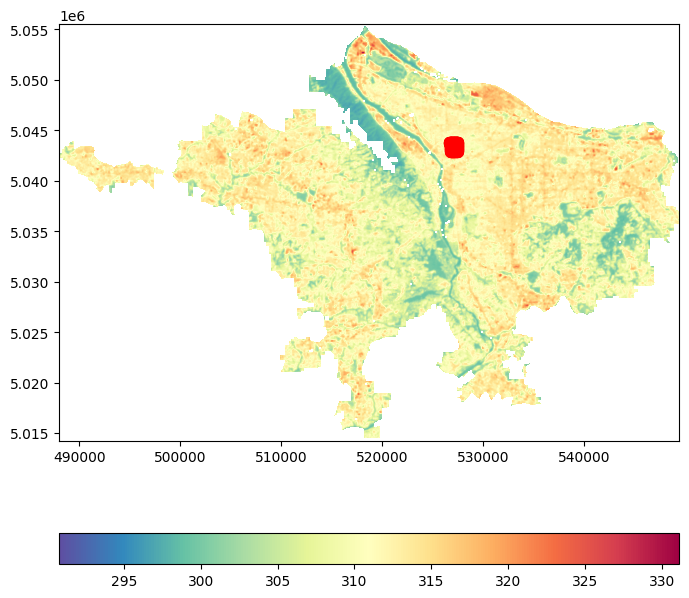

In [12]:
fig, ax = plt.subplots(1, 1, figsize=(8,8))
# df.plot(ax=ax, color='red',markersize = 10, marker='o',
#         legend = True, legend_kwds={'label':'Sampled Points','shrink': 0.3})
extent=[lst.bounds[0], lst.bounds[2], lst.bounds[1], lst.bounds[3]]
ax = rasterio.plot.show(lst.read(1), extent=extent, ax=ax, cmap='Spectral_r')
im = ax.get_images()[0]
fig.colorbar(im, ax=ax,orientation = 'horizontal')

# Add the points to the plot
ax.scatter(df['lon'], df['lat'], color='red', marker='o', s=50)

In [13]:
# Loop through each raster layer in the folder
for raster_file in sorted(os.listdir(w_folder_30)):
    # Check if file is a raster layer
    if raster_file.endswith(".tif"):
        # Open raster layer
        raster = rasterio.open(os.path.join(w_folder_30, raster_file))

        # Extract raster values at coordinates
        values = []
        for index, row in df.iterrows():
            x, y = row['lon'], row['lat']
            value = next(raster.sample([(x, y)]))[0]
            values.append(value)

        # Add raster values as a new column in the dataframe
        column_name = os.path.splitext(raster_file)[0] # Use filename as column name
        df[column_name] = values

In [14]:
df

,x,y,lon,lat,LST,ndviLandsat,gndviLandsat,eviLandsat,saviLandsat,unmixingVegLandsat,ndmiLandsat,mndwiLandsat,tasseledGreenness,area,ikurt,imax,imean,ipcumzq10,ipcumzq30,ipcumzq50,ipcumzq70,ipcumzq90,ipground,isd,iskew,itot,l_1,l_2,m0_6,m13,m18,m1_2,m1_8,m24,m2_4,m3,m32,m40,m6,m9,...,pzabove2,pzabovezmean,ratio,ratio_nonfirst_overfirst,t_3,t_4,zentropy,zkurt,zmax,zmean,zpcum1,zpcum2,zpcum3,zpcum4,zpcum5,zpcum6,zpcum7,zpcum8,zpcum9,zq10,zq15,zq20,zq25,zq30,zq35,zq40,zq45,zq5,zq50,zq55,zq60,zq65,zq70,zq75,zq80,zq85,zq90,zq95,zsd,zskew
0,1,1,526665.0,5043885.0,306.895325,0.786126,0.735941,0.572967,0.524426,0.717215,0.317821,-0.545775,0.212813,835.082153,-3.400000e+38,0.0,0.0,-3.400000e+38,-3.400000e+38,-3.400000e+38,-3.400000e+38,-3.400000e+38,-3.400000e+38,0.0,-3.400000e+38,0.0,8.734776,2.830544,0.000067,0.283795,0.243416,0.000101,0.000651,0.000000,0.001291,0.003951,0.000000,0.0,0.079219,0.219304,...,83.068405,55.088570,0.703781,0.570297,-0.113883,0.034857,-3.400000e+38,2.162378,17.292999,8.734776,7.216960,8.377187,13.137122,22.410164,37.549492,52.457024,66.516312,78.582169,95.281410,-0.001,0.002,4.4900,5.92900,6.8473,7.44800,8.1270,8.74500,-0.001,9.325000,10.022000,10.734000,11.339650,12.105700,12.899000,13.717000,14.32300,14.879000,15.456000,5.016864,-0.479409
1,2,1,526695.0,5043885.0,306.765076,0.595395,0.652659,0.397183,0.381132,0.465681,0.190074,-0.528097,0.142345,899.940002,-3.400000e+38,0.0,0.0,-3.400000e+38,-3.400000e+38,-3.400000e+38,-3.400000e+38,-3.400000e+38,-3.400000e+38,0.0,-3.400000e+38,0.0,5.649048,3.045165,0.000285,0.252160,0.105450,0.001345,0.005706,0.000217,0.009619,0.009415,0.000000,0.0,0.085548,0.117311,...,57.698891,49.135963,0.358143,0.352367,0.146734,-0.106677,-3.400000e+38,1.557109,18.128000,5.649048,21.980213,25.972458,32.782867,43.002140,52.232037,66.884293,83.379967,93.783943,98.857010,-0.002,-0.001,-0.0010,-0.00100,0.0010,0.00200,0.0020,3.62215,-0.002,5.420000,6.593000,7.816000,9.155550,10.008900,10.821250,11.460600,12.24600,13.119000,14.354000,5.491503,0.282787
2,3,1,526725.0,5043885.0,306.276520,0.753810,0.698377,0.497029,0.453232,0.587049,0.335576,-0.473853,0.167179,899.909973,-3.400000e+38,0.0,0.0,-3.400000e+38,-3.400000e+38,-3.400000e+38,-3.400000e+38,-3.400000e+38,-3.400000e+38,0.0,-3.400000e+38,0.0,10.449761,5.124403,0.000013,0.097748,0.198743,0.000026,0.000065,0.214430,0.000078,0.001134,0.062449,0.0,0.012753,0.031935,...,61.938789,53.299778,0.487879,0.525657,0.063999,-0.105439,-3.400000e+38,1.485272,28.230000,10.449761,19.202929,20.790258,23.935963,33.230011,42.013115,57.593460,75.771095,88.527634,95.338501,-0.002,-0.001,-0.0010,0.00100,0.0010,0.00200,6.9558,9.97700,-0.002,11.817000,13.970000,15.083000,16.263901,17.563000,18.514000,19.490999,20.48600,22.149000,24.691700,9.177834,0.051727
3,4,1,526755.0,5043885.0,306.178711,0.802920,0.722380,0.635395,0.552259,0.815796,0.368826,-0.481966,0.229147,899.940002,-3.400000e+38,0.0,0.0,-3.400000e+38,-3.400000e+38,-3.400000e+38,-3.400000e+38,-3.400000e+38,-3.400000e+38,0.0,-3.400000e+38,0.0,14.553475,3.609514,0.000014,0.120623,0.345686,0.000028,0.000324,0.351988,0.000493,0.000493,0.010361,0.0,0.012504,0.034494,...,87.655762,62.996899,1.411830,0.906134,-0.239797,0.124187,-3.400000e+38,3.141512,27.087000,14.553475,5.122216,6.171087,8.667308,15.340693,25.968336,44.446480,69.504875,91.002914,99.216782,0.001,7.507,10.1328,11.94000,13.1660,14.21865,15.0370,15.76800,-0.001,16.403999,16.919001,17.500999,18.157000,18.726000,19.385000,20.016001,20.62715,21.320000,22.417000,6.734739,-1.031521
4,5,1,526785.0,5043885.0,306.668488,0.742103,0.696173,0.592156,0.522805,0.750382,0.288996,-0.509731,0.218472,899.909973,-3.400000e+38,0.0,0.0,-3.400000e+38,-3.400000e+38,-3.400000e+38,-3.400000e+38,-3.400000e+38,-3.400000e+38,0.0,-3.400000e+38,0.0,11.660475,4.263415,0.000000,0.138635,0.305227,0.000028,0.000028,0.230664,0.000028,0.000097,0.001362,0.0,0.021218,0.065211,...,76.259621,59.956089,1.343523,0.901641,-0.114089,-0.019309,-3.400000e+38,1.834507,24.864000,11.660475,10.77

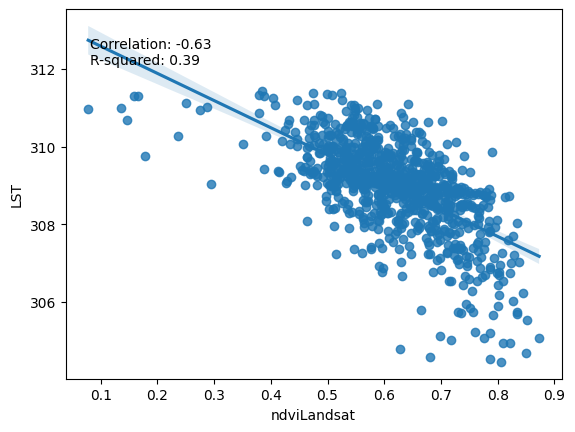

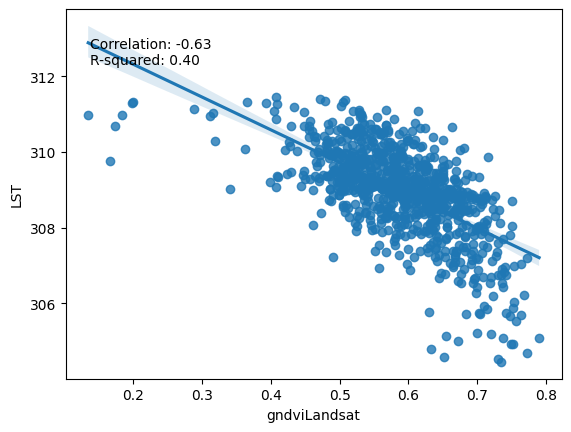

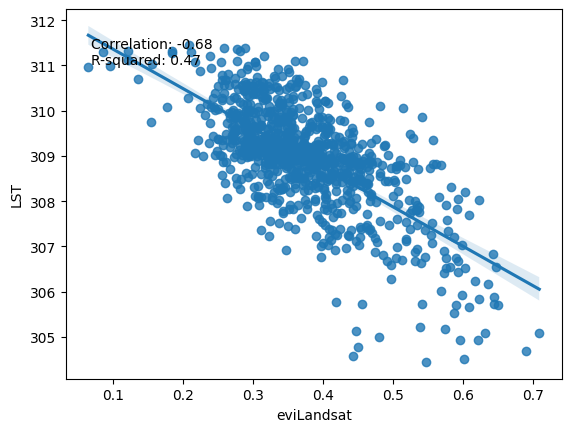

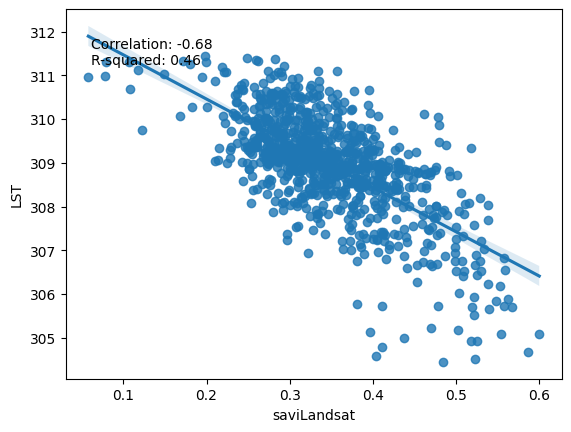

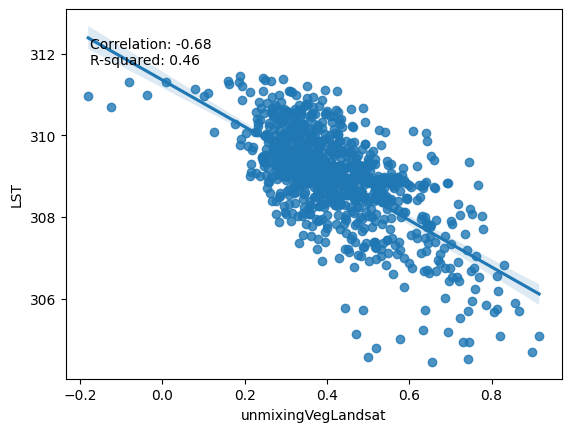

...

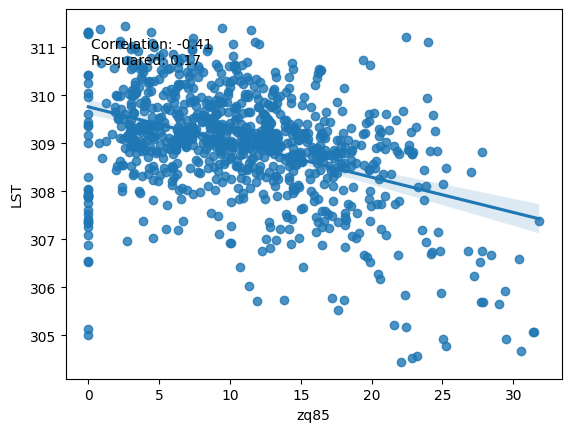

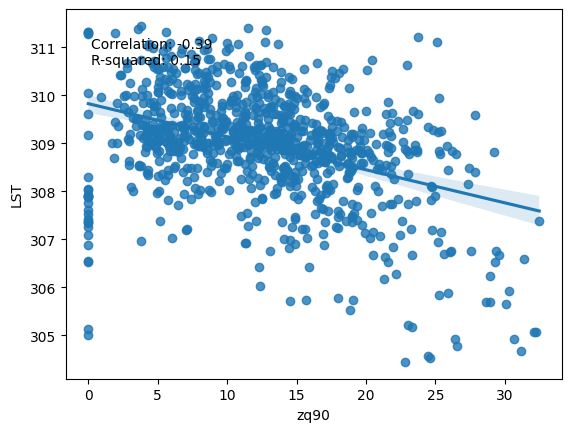

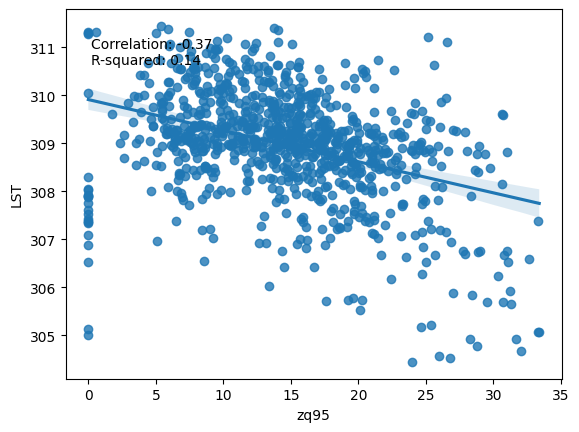

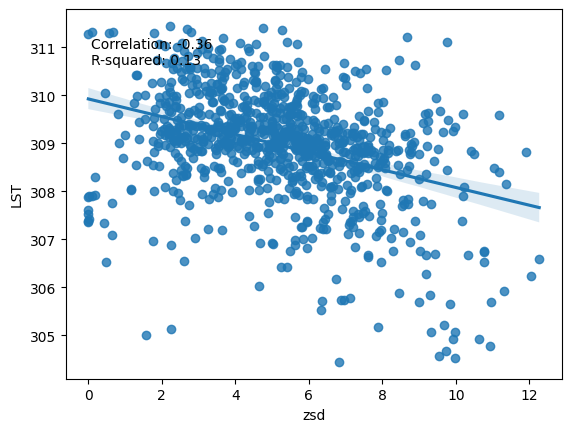

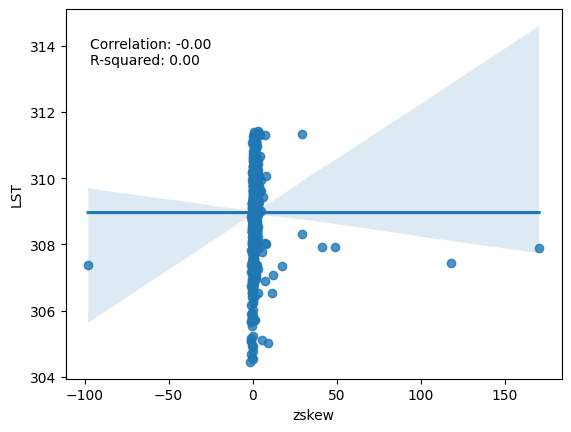

In [15]:
# get the correlation between column 5 and all the other columns since column 6
corr = df.iloc[:, 5:].corrwith(df['LST'])

# loop through each column and create a scatter plot with correlation line and R-squared value
for i in range(len(corr)):
    if not pd.isna(corr[i]):
        fig, ax = plt.subplots()
        sns.regplot(x=df.iloc[:, i+5], y=df['LST'], ax=ax)
        ax.set_xlabel(df.columns[i+5])
        ax.set_ylabel('LST')
        corr_label = 'Correlation: {:.2f}'.format(corr[i])
        r2_label = 'R-squared: {:.2f}'.format(corr[i]**2)
        ax.annotate(corr_label + '\n' + r2_label, xy=(0.05, 0.85), xycoords='axes fraction')
        plt.show()

In [16]:
# Print out the column names
print(df.columns)

Index(['x', 'y', 'lon', 'lat', 'LST', 'ndviLandsat', 'gndviLandsat',
       'eviLandsat', 'saviLandsat', 'unmixingVegLandsat', 'ndmiLandsat',
       'mndwiLandsat', 'tasseledGreenness', 'area', 'ikurt', 'imax', 'imean',
       'ipcumzq10', 'ipcumzq30', 'ipcumzq50', 'ipcumzq70', 'ipcumzq90',
       'ipground', 'isd', 'iskew', 'itot', 'l_1', 'l_2', 'm0_6', 'm13', 'm18',
       'm1_2', 'm1_8', 'm24', 'm2_4', 'm3', 'm32', 'm40', 'm6', 'm9', 'n',
       'n_1st', 'n_234th', 'n_multiple', 'n_single', 'p1th', 'p2th', 'p3th',
       'p4th', 'p5th', 'pground', 'pzabove2', 'pzabovezmean', 'ratio',
       'ratio_nonfirst_overfirst', 't_3', 't_4', 'zentropy', 'zkurt', 'zmax',
       'zmean', 'zpcum1', 'zpcum2', 'zpcum3', 'zpcum4', 'zpcum5', 'zpcum6',
       'zpcum7', 'zpcum8', 'zpcum9', 'zq10', 'zq15', 'zq20', 'zq25', 'zq30',
       'zq35', 'zq40', 'zq45', 'zq5', 'zq50', 'zq55', 'zq60', 'zq65', 'zq70',
       'zq75', 'zq80', 'zq85', 'zq90', 'zq95', 'zsd', 'zskew'],
      dtype='object')


In [17]:
# Define the dependent variable
y = df['LST']

# Define the independent variables
x_cols = ['m0_6', 'm1_2', 'm1_8', 'm2_4', 'm3', 'm6','m9','m13','m18','m24','m32','m40']  # Replace with your list of column names
X = df[x_cols]

# Fit the linear regression model
model = LinearRegression().fit(X, y)
# Print the coefficients
print('Coefficients:', model.coef_)
# Print the intercept
print('Intercept:', model.intercept_)
# Print the R-squared value
print('R-squared:', model.score(X, y))

Coefficients: [-30.013836   38.787964   13.934966  -11.010431    3.1369905  -0.1291256
   1.0069056   0.9323597  -3.31011    -1.5488205  -5.8174796   0.2523597]
Intercept: 309.047
R-squared: 0.276867475798639


In [18]:
# Define the dependent variable
y = df['LST']

# Define the independent variables
x_cols = ['zq5','zq10', 'zq15', 'zq20', 'zq25', 'zq30', 'zq35','zq40','zq45','zq50','zq55','zq60','zq65','zq70','zq75','zq80','zq85','zq90']  # Replace with your list of column names
X = df[x_cols]

# Fit the linear regression model
model = LinearRegression().fit(X, y)
# Print the coefficients
print('Coefficients:', model.coef_)
# Print the intercept
print('Intercept:', model.intercept_)
# Print the R-squared value
print('R-squared:', model.score(X, y))

Coefficients: [ 6.4999054e+02 -2.1842763e-01  1.4113860e-01 -2.8917590e-01
  1.4343043e-01 -1.1205937e-01  1.1004554e-01 -8.4529549e-02
 -6.1166856e-02  5.4683425e-02 -7.4911945e-02  9.8119467e-02
 -7.8246504e-02 -9.7329356e-02  1.6851524e-01 -1.0242523e-01
  1.3420075e-02  2.5558472e-03]
Intercept: 310.69562
R-squared: 0.26417813201960927


In [19]:
# export the dataframe to a csv file
df.to_csv('/content/drive/MyDrive/XihanYAO_GISDataShare/230102_CityScaleAnalysis(LST,NDVI,GNDVI,EVI,SAVI,VegUmixing,NDBI,NDWI)/230403LSTRegressionW.csv', index=False)

# East Area

In [20]:
file_path = e_folder_30 + "/area.tif"
srcE = rasterio.open(file_path)

Raster shape: (56, 38)
Raster CRS: EPSG:32610
Raster extent: BoundingBox(left=538200.0, bottom=5039070.0, right=539340.0, top=5040750.0)


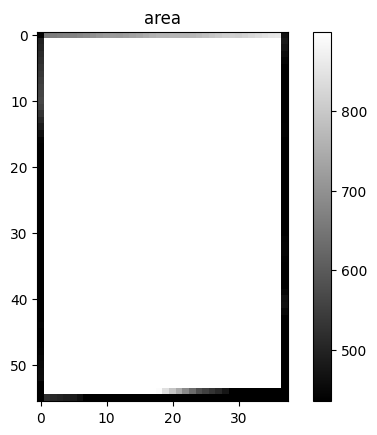

In [21]:
# Read the first band (layer) of the raster
band = srcE.read(1)

# Get the 5th and 95th percentiles of the pixel values
p5, p95 = np.percentile(band, (5, 95))

# Get the file name without the extension
file_name = os.path.splitext(os.path.basename(file_path))[0]

# Get some information about the raster
print(f"Raster shape: {srcE.shape}")
print(f"Raster CRS: {srcE.crs}")
print(f"Raster extent: {srcE.bounds}")

# Display the raster
fig, ax = plt.subplots()
im = ax.imshow(band, cmap='gray', vmin=p5, vmax=p95, interpolation='none')
ax.set_title(file_name)
fig.colorbar(im, ax=ax)
plt.show()

Raster shape: (56, 38)
Raster CRS: EPSG:32610
Raster extent: BoundingBox(left=538200.0, bottom=5039070.0, right=539340.0, top=5040750.0)


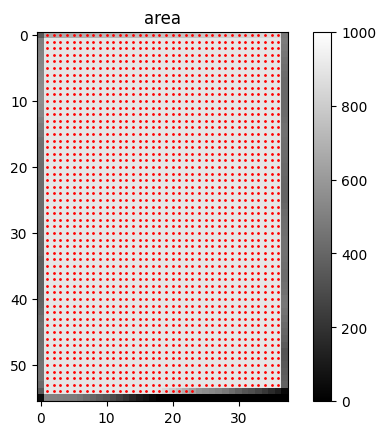

       x   y       lon        lat
0      1   0  538245.0  5040735.0
1      2   0  538275.0  5040735.0
2      3   0  538305.0  5040735.0
3      4   0  538335.0  5040735.0
4      5   0  538365.0  5040735.0
...   ..  ..       ...        ...
1962  19  54  538785.0  5039115.0
1963  20  54  538815.0  5039115.0
1964  21  54  538845.0  5039115.0
1965  22  54  538875.0  5039115.0
1966  23  54  538905.0  5039115.0

[1967 rows x 4 columns]


In [22]:
# Get the geospatial coordinates of the center of each pixel
indices = np.where(band > 600)
x, y = rasterio.transform.xy(srcE.transform, indices[0], indices[1], offset='center')

# Create a DataFrame with the pixel coordinates and geospatial coordinates
dfE = pd.DataFrame({'x': indices[1], 'y': indices[0], 'lon': x, 'lat': y})

# Get the file name without the extension
file_name = os.path.splitext(os.path.basename(file_path))[0]

# Get some information about the raster
print(f"Raster shape: {srcE.shape}")
print(f"Raster CRS: {srcE.crs}")
print(f"Raster extent: {srcE.bounds}")

# Display the raster
fig, ax = plt.subplots()
im = ax.imshow(band, cmap='gray', vmin=0, vmax=1000, interpolation='none')
ax.set_title(file_name)
fig.colorbar(im, ax=ax)

# Plot the coordinates of the selected pixels as red dots
ax.plot(dfE['x'], dfE['y'], 'ro', markersize=1)

plt.show()

# Print the DataFrame with the pixel and geospatial coordinates
print(dfE)

In [23]:
# # Define a function to extract the raster value at a given point
# def extract_raster_value(point, srcE):
#     x, y = point['lon'], point['lat']
#     row, col = srcE.read(1).index(x, y)
#     return srcE.read(1, window=((row, row+1), (col, col+1)))[0][0]

In [24]:
# Extract raster values at coordinates
values0 = []
values2 = []
values3 = []
values4 = []
values5 = []
values6 = []
values7 = []
values8 = []
values9 = []
for index, row in dfE.iterrows():
    x, y = row['lon'], row['lat']
    value0 = next(lst.sample([(x, y)]))[0]
    values0.append(value0)
    value2 = next(lst.sample([(x, y)]))[2]
    values2.append(value2)
    value3 = next(lst.sample([(x, y)]))[3]
    values3.append(value3)
    value4 = next(lst.sample([(x, y)]))[4]
    values4.append(value4)
    value5 = next(lst.sample([(x, y)]))[5]
    values5.append(value5)
    value6 = next(lst.sample([(x, y)]))[6]
    values6.append(value6)
    value7 = next(lst.sample([(x, y)]))[7]
    values7.append(value7)
    value8 = next(lst.sample([(x, y)]))[8]
    values8.append(value8)
    value9 = next(lst.sample([(x, y)]))[9]
    values9.append(value9)

# Add raster values as a new column in the dataframe
dfE['LST'] = values0
dfE['ndviLandsat'] = values2
dfE['gndviLandsat'] = values3
dfE['eviLandsat'] = values4
dfE['saviLandsat'] = values5
dfE['unmixingVegLandsat'] = values6
dfE['ndmiLandsat'] = values7
dfE['mndwiLandsat'] = values8
dfE['tasseledGreenness'] = values9
dfE

,x,y,lon,lat,LST,ndviLandsat,gndviLandsat,eviLandsat,saviLandsat,unmixingVegLandsat,ndmiLandsat,mndwiLandsat,tasseledGreenness
0,1,0,538245.0,5040735.0,316.404022,0.100743,0.119186,0.064087,0.059390,0.029736,0.002631,-0.116592,-0.022578
1,2,0,538275.0,5040735.0,315.699219,0.106690,0.162614,0.056999,0.056480,0.014886,-0.008940,-0.171305,-0.014299
2,3,0,538305.0,5040735.0,315.181458,0.370341,0.388518,0.174854,0.172280,0.129759,0.112429,-0.288700,0.035584
3,4,0,538335.0,5040735.0,314.724579,0.239059,0.274040,0.101734,0.105465,0.051492,0.041382,-0.235326,0.011508
4,5,0,538365.0,5040735.0,313.993683,0.504039,0.496762,0.239556,0.235541,0.182756,0.115875,-0.404151,0.061564
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1962,19,54,538785.0,5039115.0,313.277588,0.245055,0.274422,0.135757,0.121948,0.108382,0.110468,-0.169079,0.011017
1963,20,54,538815.0,5039115.0,313.350525,0.292183,0.290880,0.130908,0.133061,0.093077,0.073693,-0.221944,0.021299
1964,21,54,538845.0,5039115.0,313.588745,0.371167,0.369174,0.158660,0.163426,0.131389,0.152032,-0.230054,0.034035
1965,22,54,538875.0,5039115.0,313.853790,0.317870,0.327175,0.144121,0.145533,0.115633,0.120973,-0.214699,0.026076


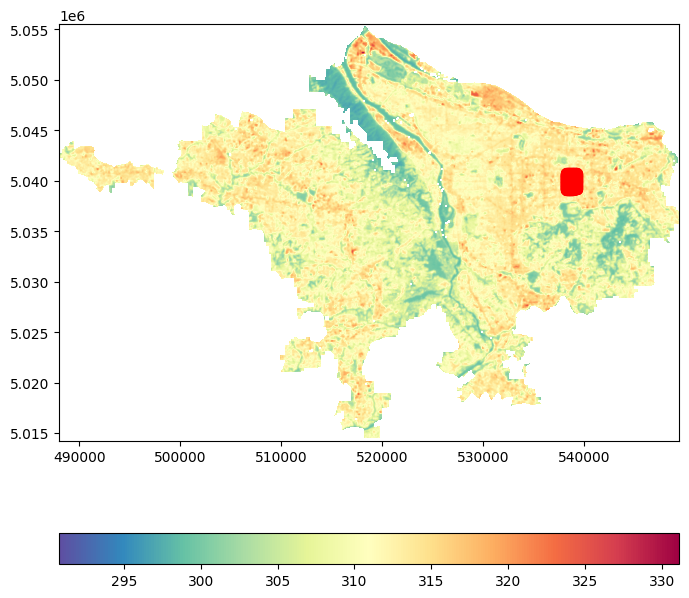

In [25]:
fig, ax = plt.subplots(1, 1, figsize=(8,8))
# dfE.plot(ax=ax, color='red',markersize = 10, marker='o',
#         legend = True, legend_kwds={'label':'Sampled Points','shrink': 0.3})
extent=[lst.bounds[0], lst.bounds[2], lst.bounds[1], lst.bounds[3]]
ax = rasterio.plot.show(lst.read(1), extent=extent, ax=ax, cmap='Spectral_r')
im = ax.get_images()[0]
fig.colorbar(im, ax=ax,orientation = 'horizontal')

# Add the points to the plot
ax.scatter(dfE['lon'], dfE['lat'], color='red', marker='o', s=50)

In [26]:
# Loop through each raster layer in the folder
for raster_file in sorted(os.listdir(e_folder_30)):
    # Check if file is a raster layer
    if raster_file.endswith(".tif"):
        # Open raster layer
        raster = rasterio.open(os.path.join(e_folder_30, raster_file))

        # Extract raster values at coordinates
        values = []
        for index, row in dfE.iterrows():
            x, y = row['lon'], row['lat']
            value = next(raster.sample([(x, y)]))[0]
            values.append(value)

        # Add raster values as a new column in the dataframe
        column_name = os.path.splitext(raster_file)[0] # Use filename as column name
        dfE[column_name] = values

In [27]:
dfE

,x,y,lon,lat,LST,ndviLandsat,gndviLandsat,eviLandsat,saviLandsat,unmixingVegLandsat,ndmiLandsat,mndwiLandsat,tasseledGreenness,area,ikurt,imax,imean,ipcumzq10,ipcumzq30,ipcumzq50,ipcumzq70,ipcumzq90,ipground,isd,iskew,itot,l_1,l_2,m0_6,m13,m18,m1_2,m1_8,m24,m2_4,m3,m32,m40,m6,m9,...,pzabove2,pzabovezmean,ratio,ratio_nonfirst_overfirst,t_3,t_4,zentropy,zkurt,zmax,zmean,zpcum1,zpcum2,zpcum3,zpcum4,zpcum5,zpcum6,zpcum7,zpcum8,zpcum9,zq10,zq15,zq20,zq25,zq30,zq35,zq40,zq45,zq5,zq50,zq55,zq60,zq65,zq70,zq75,zq80,zq85,zq90,zq95,zsd,zskew
0,1,0,538245.0,5040735.0,316.404022,0.100743,0.119186,0.064087,0.059390,0.029736,0.002631,-0.116592,-0.022578,658.216125,-3.400000e+38,0.0,0.0,-3.400000e+38,-3.400000e+38,-3.400000e+38,-3.400000e+38,-3.400000e+38,-3.400000e+38,0.0,-3.400000e+38,0.0,0.244839,0.239609,0.001401,0.012350,0.000000,0.004399,0.004595,0.000000,0.009026,0.008863,0.000000,0.0,0.007430,0.002151,...,3.783238,5.024765,0.038779,0.036757,0.939520,0.863123,-3.400000e+38,55.597832,12.770000,0.244839,89.392151,93.544075,95.274040,96.013214,96.602974,96.783836,96.988281,97.200600,97.766769,-0.002,-0.002,-0.002,-0.002,-0.001,-0.001,-0.001,-0.001,-0.002,-0.001,-0.001,0.001,0.001,0.0010,0.0010,0.001,0.00200,0.0020,0.450250,1.411335,7.092408
1,2,0,538275.0,5040735.0,315.699219,0.106690,0.162614,0.056999,0.056480,0.014886,-0.008940,-0.171305,-0.014299,661.897949,-3.400000e+38,0.0,0.0,-3.400000e+38,-3.400000e+38,-3.400000e+38,-3.400000e+38,-3.400000e+38,-3.400000e+38,0.0,-3.400000e+38,0.0,0.387968,0.368651,0.007410,0.012588,0.000000,0.010614,0.021648,0.000000,0.010743,0.010646,0.000000,0.0,0.035175,0.002071,...,6.572177,10.782125,0.044384,0.043139,0.862541,0.715277,-3.400000e+38,37.309086,12.295000,0.387968,79.548058,86.820656,92.326942,96.639015,96.767738,97.146736,97.175346,97.647308,97.833237,-0.002,-0.002,-0.002,-0.002,-0.001,-0.001,-0.001,-0.001,-0.002,-0.001,0.001,0.001,0.001,0.0010,0.0020,0.002,0.00200,0.8210,2.996900,1.513364,5.477887
2,3,0,538305.0,5040735.0,315.181458,0.370341,0.388518,0.174854,0.172280,0.129759,0.112429,-0.288700,0.035584,667.223267,-3.400000e+38,0.0,0.0,-3.400000e+38,-3.400000e+38,-3.400000e+38,-3.400000e+38,-3.400000e+38,-3.400000e+38,0.0,-3.400000e+38,0.0,0.245156,0.235823,0.005398,0.005856,0.000000,0.009226,0.019663,0.000000,0.010077,0.007950,0.000000,0.0,0.010764,0.008147,...,3.736300,7.655816,0.040352,0.038108,0.913637,0.800397,-3.400000e+38,53.450840,11.872000,0.245156,85.482773,92.336235,95.585007,96.508896,96.705795,97.606964,98.599014,98.652023,98.780762,-0.002,-0.002,-0.002,-0.002,-0.001,-0.001,-0.001,-0.001,-0.002,-0.001,-0.001,0.001,0.001,0.0010,0.0010,0.002,0.00200,0.0020,1.635800,1.173578,6.677186
3,4,0,538335.0,5040735.0,314.724579,0.239059,0.274040,0.101734,0.105465,0.051492,0.041382,-0.235326,0.011508,671.152893,-3.400000e+38,0.0,0.0,-3.400000e+38,-3.400000e+38,-3.400000e+38,-3.400000e+38,-3.400000e+38,-3.400000e+38,0.0,-3.400000e+38,0.0,0.173149,0.171975,0.000430,0.012798,0.000000,0.001124,0.002050,0.000000,0.002943,0.000165,0.000000,0.0,0.000761,0.001918,...,1.802368,2.225676,0.030642,0.029799,0.962251,0.918037,-3.400000e+38,65.959015,11.984000,0.173149,94.846382,96.101753,96.192596,96.225639,96.333000,96.506439,96.580772,96.861580,97.109352,-0.002,-0.002,-0.002,-0.002,-0.001,-0.001,-0.001,-0.001,-0.002,-0.001,-0.001,0.001,0.001,0.0010,0.0010,0.001,0.00200,0.0020,0.002000,1.321833,7.980359
4,5,0,538365.0,5040735.0,313.993683,0.504039,0.496762,0.239556,0.235541,0.182756,0.115875,-0.404151,0.061564,675.877441,-3.400000e+38,0.0,0.0,-3.400000e+38,-3.400000e+38,-3.400000e+38,-3.400000e+38,-3.400000e+38,-3.400000e+38,0.0,-3.400000e+38,0.0,0.834867,0.764074,0.000638,0.034531,0.001244,0.002487,0.006855,0.000000,0.025890,0.006791,0.000000,0.0,0.022160,0.031279,...,11.838791,13.075917,0.057094,0.054750,0.825835,0.612562,-3.400000e+38,12.816589,13.645000,0.834867,72.669708,80.799347,82.120239,84.762032,86.620819,90.004768,93.000610,95.601555,98.495270,-0.002,-0.002,-0.002,-0.002,-0.001,-0.001,-0.001,-0.0

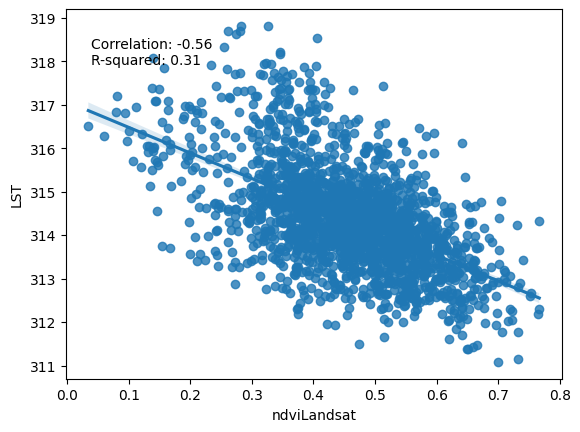

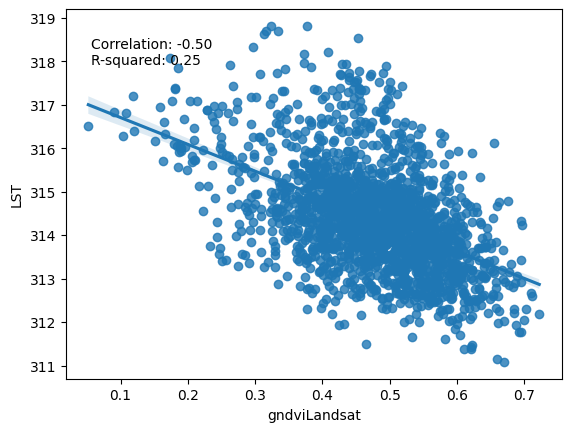

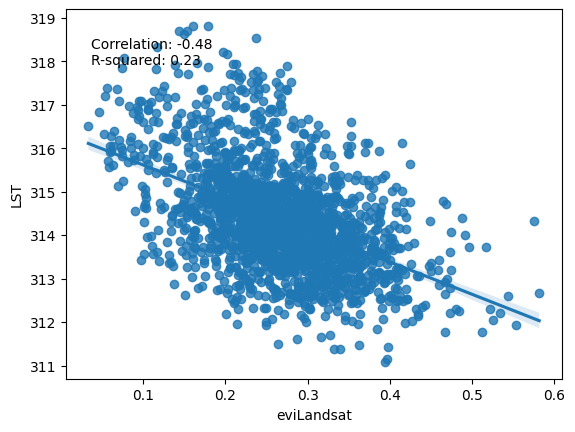

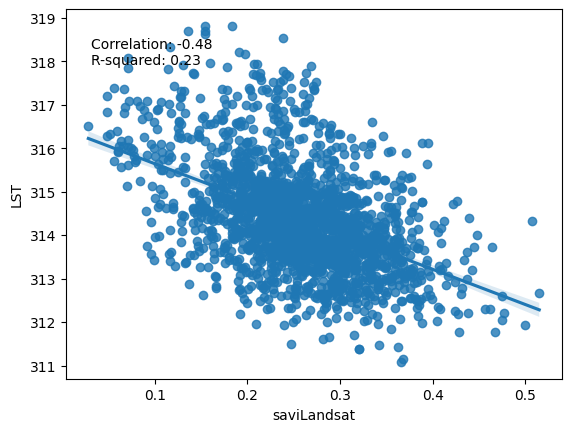

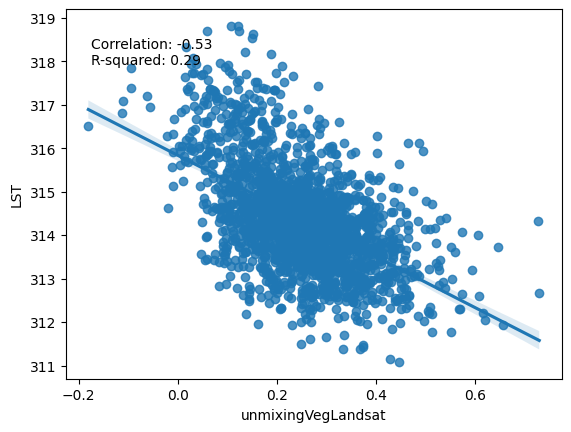

...

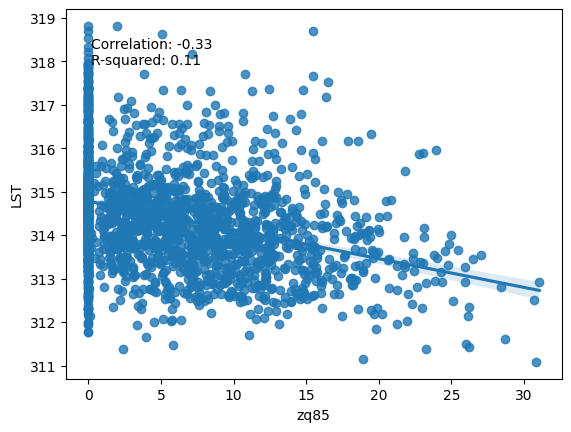

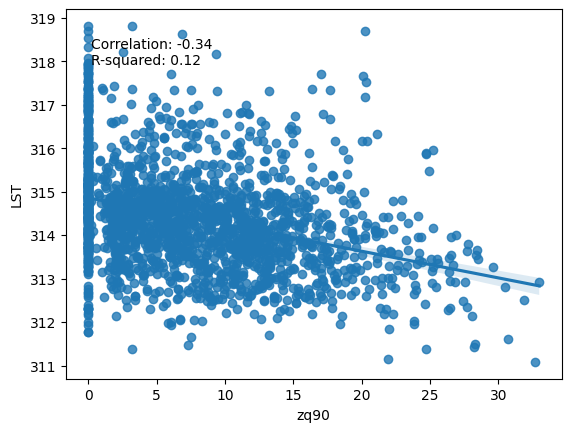

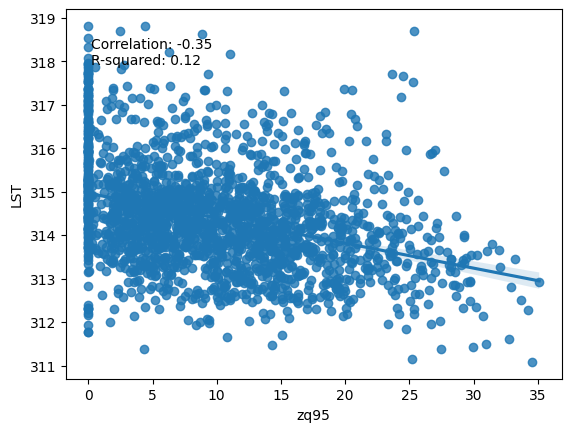

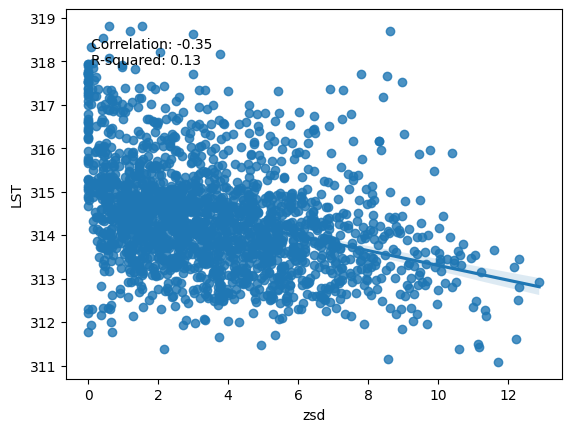

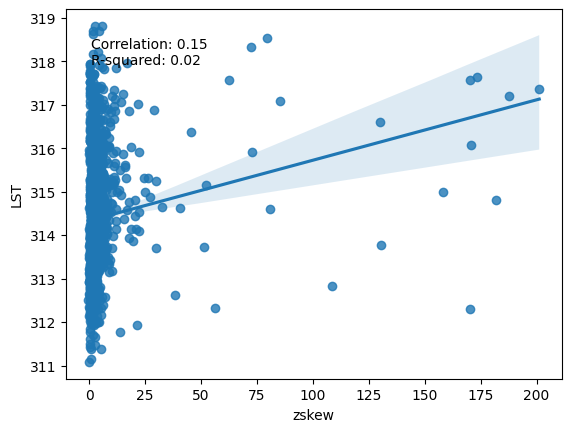

In [28]:
# get the correlation between column 5 and all the other columns since column 6
corr = dfE.iloc[:, 5:].corrwith(dfE['LST'])

# loop through each column and create a scatter plot with correlation line and R-squared value
for i in range(len(corr)):
    if not pd.isna(corr[i]):
        fig, ax = plt.subplots()
        sns.regplot(x=dfE.iloc[:, i+5], y=dfE['LST'], ax=ax)
        ax.set_xlabel(dfE.columns[i+5])
        ax.set_ylabel('LST')
        corr_label = 'Correlation: {:.2f}'.format(corr[i])
        r2_label = 'R-squared: {:.2f}'.format(corr[i]**2)
        ax.annotate(corr_label + '\n' + r2_label, xy=(0.05, 0.85), xycoords='axes fraction')
        plt.show()

In [29]:
# Print out the column names
print(dfE.columns)

Index(['x', 'y', 'lon', 'lat', 'LST', 'ndviLandsat', 'gndviLandsat',
       'eviLandsat', 'saviLandsat', 'unmixingVegLandsat', 'ndmiLandsat',
       'mndwiLandsat', 'tasseledGreenness', 'area', 'ikurt', 'imax', 'imean',
       'ipcumzq10', 'ipcumzq30', 'ipcumzq50', 'ipcumzq70', 'ipcumzq90',
       'ipground', 'isd', 'iskew', 'itot', 'l_1', 'l_2', 'm0_6', 'm13', 'm18',
       'm1_2', 'm1_8', 'm24', 'm2_4', 'm3', 'm32', 'm40', 'm6', 'm9', 'n',
       'n_1st', 'n_234th', 'n_multiple', 'n_single', 'p1th', 'p2th', 'p3th',
       'p4th', 'p5th', 'pground', 'pzabove2', 'pzabovezmean', 'ratio',
       'ratio_nonfirst_overfirst', 't_3', 't_4', 'zentropy', 'zkurt', 'zmax',
       'zmean', 'zpcum1', 'zpcum2', 'zpcum3', 'zpcum4', 'zpcum5', 'zpcum6',
       'zpcum7', 'zpcum8', 'zpcum9', 'zq10', 'zq15', 'zq20', 'zq25', 'zq30',
       'zq35', 'zq40', 'zq45', 'zq5', 'zq50', 'zq55', 'zq60', 'zq65', 'zq70',
       'zq75', 'zq80', 'zq85', 'zq90', 'zq95', 'zsd', 'zskew'],
      dtype='object')


In [30]:
# Define the dependent variable
y = dfE['LST']

# Define the independent variables
x_cols = ['m0_6', 'm1_2', 'm1_8', 'm2_4', 'm3', 'm6','m9','m13','m18','m24','m32','m40']  # Replace with your list of column names
X = dfE[x_cols]

# Fit the linear regression model
model = LinearRegression().fit(X, y)
# Print the coefficients
print('Coefficients:', model.coef_)
# Print the intercept
print('Intercept:', model.intercept_)
# Print the R-squared value
print('R-squared:', model.score(X, y))

Coefficients: [-32.31158     24.63179    -34.00707      3.7422314  -12.844223
  -0.85793066  -3.5008144   -2.2397397   -2.5028415   -1.2755618
  -5.7696886   -9.565536  ]
Intercept: 315.3279
R-squared: 0.19423998994056557


In [31]:
# Define the dependent variable
y = dfE['LST']

# Define the independent variables
x_cols = ['zq5','zq10', 'zq15', 'zq20', 'zq25', 'zq30', 'zq35','zq40','zq45','zq50','zq55','zq60','zq65','zq70','zq75','zq80','zq85','zq90']  # Replace with your list of column names
X = dfE[x_cols]

# Fit the linear regression model
model = LinearRegression().fit(X, y)
# Print the coefficients
print('Coefficients:', model.coef_)
# Print the intercept
print('Intercept:', model.intercept_)
# Print the R-squared value
print('R-squared:', model.score(X, y))

Coefficients: [ 0.0000000e+00 -6.8023273e+02 -3.1510513e+02 -1.3854212e-01
  9.2921257e-03 -6.2117577e-02  2.5757360e-01 -6.6638947e-02
 -5.5507660e-02  5.5282593e-02 -2.6874542e-02  8.7890625e-02
 -6.8435669e-02  1.7593384e-02 -9.2620850e-02  2.8228760e-02
  1.1538696e-01 -1.2408447e-01]
Intercept: 312.8656
R-squared: 0.13527357960335928


In [32]:
# export the dataframe to a csv file
dfE.to_csv('/content/drive/MyDrive/XihanYAO_GISDataShare/230102_CityScaleAnalysis(LST,NDVI,GNDVI,EVI,SAVI,VegUmixing,NDBI,NDWI)/230403LSTRegressionE.csv', index=False)

# Combined

In [33]:
# Concatenate the dataframes and add a new column
dfAll = pd.concat([df, dfE])
dfAll['origin'] = ['W'] * len(df) + ['E'] * len(dfE)
# Reorder the columns
dfAll = dfAll.reindex(columns=['x', 'y', 'origin'] + list(dfAll.columns[2:-1]))

print(dfAll)

       x   y origin       lon        lat         LST  ndviLandsat  \
0      1   1      W  526665.0  5043885.0  306.895325     0.786126   
1      2   1      W  526695.0  5043885.0  306.765076     0.595395   
2      3   1      W  526725.0  5043885.0  306.276520     0.753810   
3      4   1      W  526755.0  5043885.0  306.178711     0.802920   
4      5   1      W  526785.0  5043885.0  306.668488     0.742103   
...   ..  ..    ...       ...        ...         ...          ...   
1962  19  54      E  538785.0  5039115.0  313.277588     0.245055   
1963  20  54      E  538815.0  5039115.0  313.350525     0.292183   
1964  21  54      E  538845.0  5039115.0  313.588745     0.371167   
1965  22  54      E  538875.0  5039115.0  313.853790     0.317870   
1966  23  54      E  538905.0  5039115.0  314.116943     0.243652   

      gndviLandsat  eviLandsat  saviLandsat  unmixingVegLandsat  ndmiLandsat  \
0         0.735941    0.572967     0.524426            0.717215     0.317821   
1         0

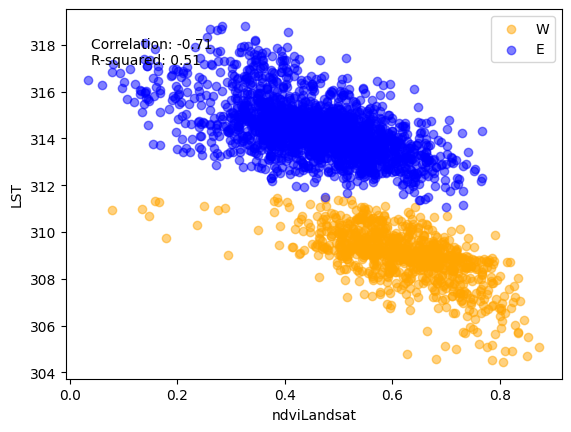

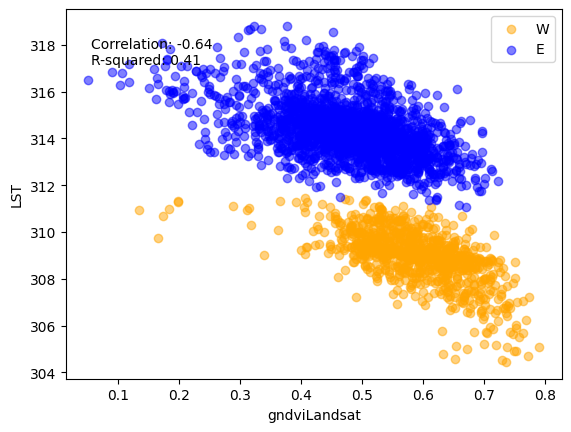

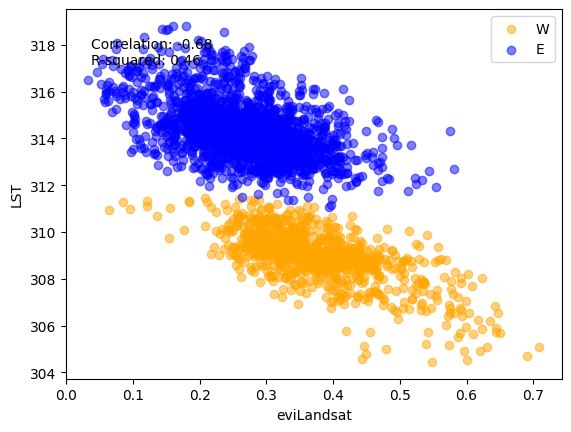

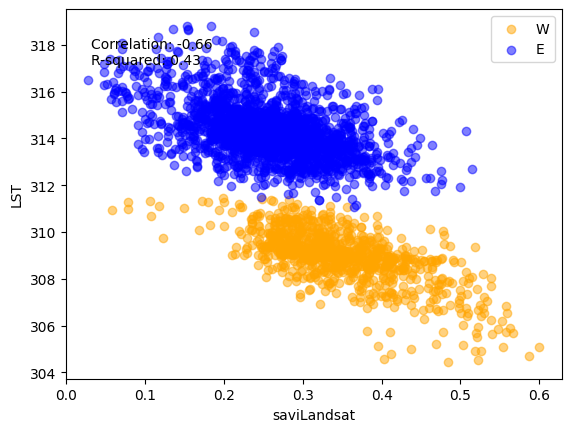

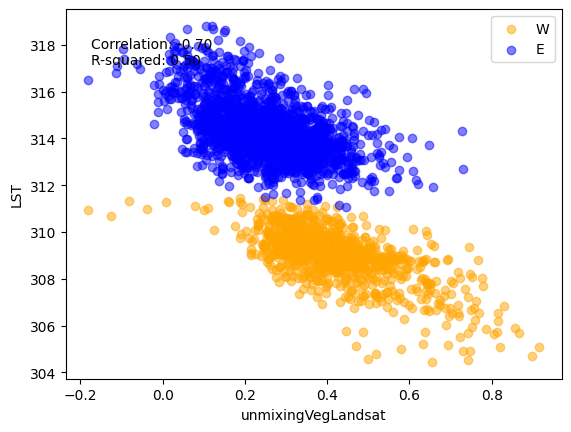

...

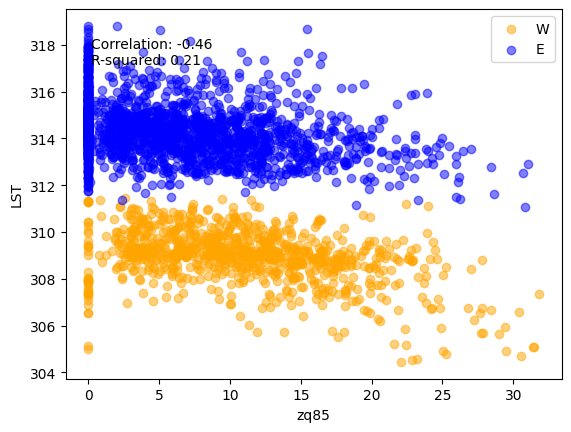

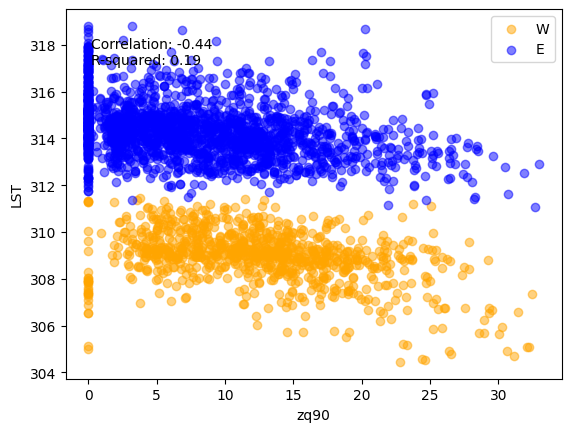

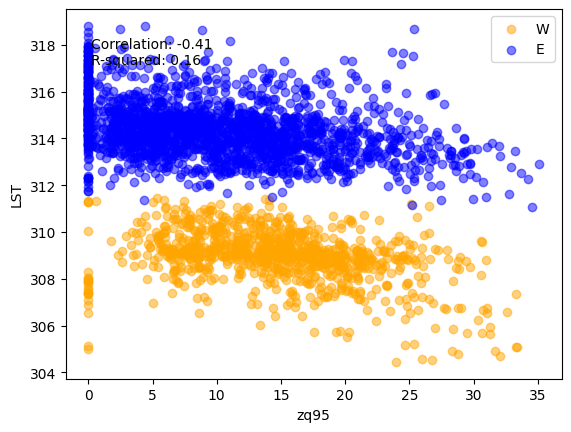

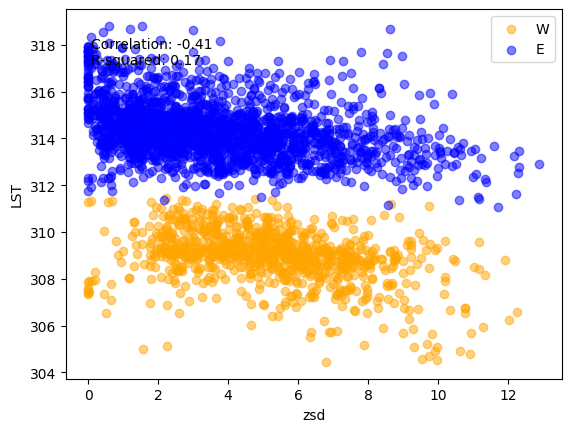

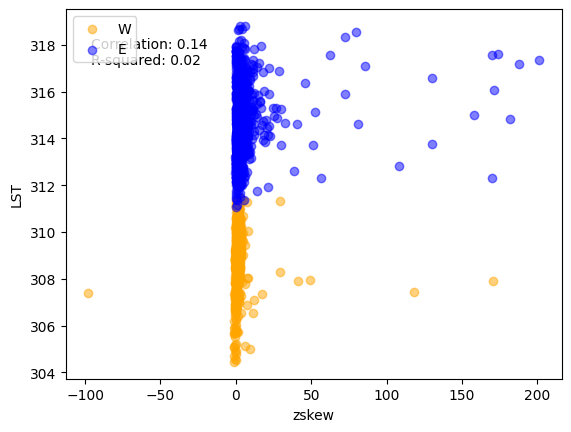

In [34]:
# Define color map for categories
category_colors = {'W': 'orange', 'E': 'blue'}

# get the correlation between column 5 and all the other columns since column 6
corr = dfAll.iloc[:, 6:].corrwith(dfAll['LST'])

# loop through each column and create a scatter plot with correlation line and R-squared value
for i in range(len(corr)):
    if not pd.isna(corr[i]):
        fig, ax = plt.subplots()
        
        # Add color to scatter plot based on category column
        for category, color in category_colors.items():
            ax.scatter(x=dfAll.loc[dfAll['origin']==category].iloc[:, i+6], 
                       y=dfAll.loc[dfAll['origin']==category]['LST'], 
                       color=color, 
                       alpha=0.5, 
                       label=category)
        
        ax.set_xlabel(dfAll.columns[i+6])
        ax.set_ylabel('LST')
        corr_label = 'Correlation: {:.2f}'.format(corr[i])
        r2_label = 'R-squared: {:.2f}'.format(corr[i]**2)
        ax.annotate(corr_label + '\n' + r2_label, xy=(0.05, 0.85), xycoords='axes fraction')
        ax.legend()
        plt.show()


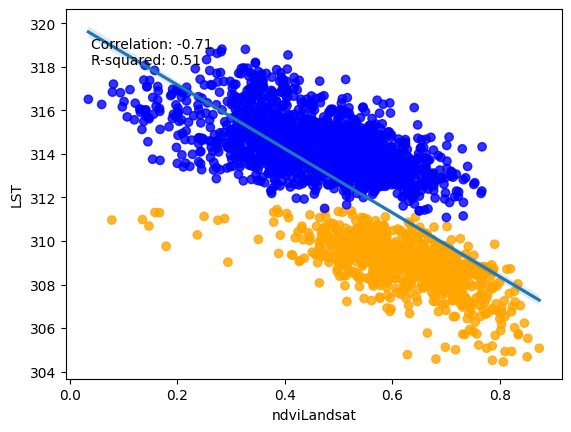

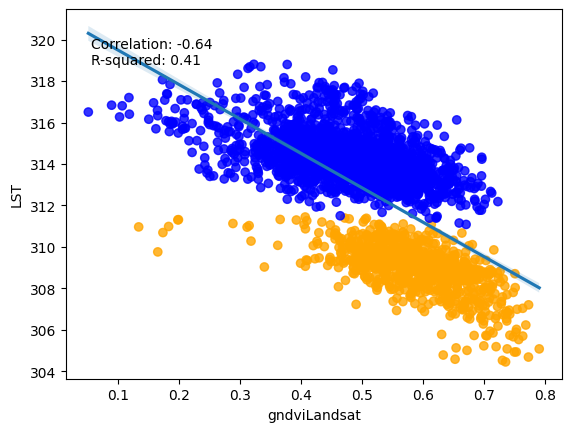

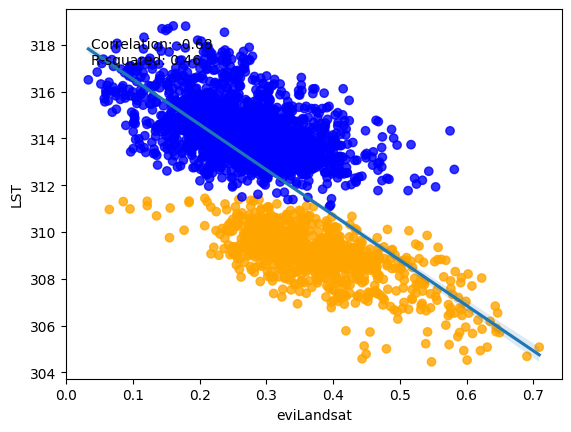

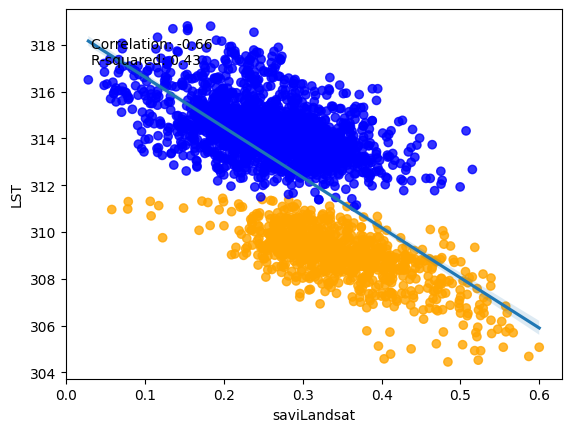

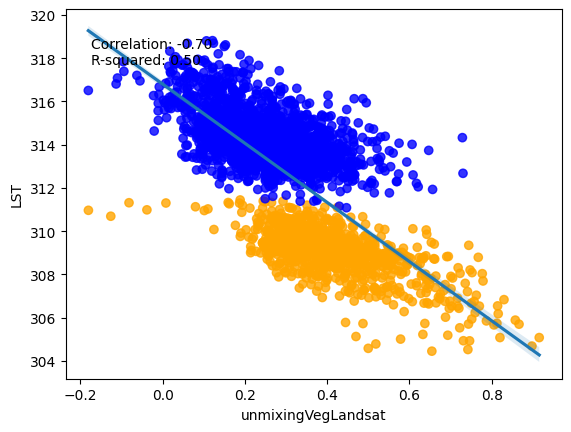

...

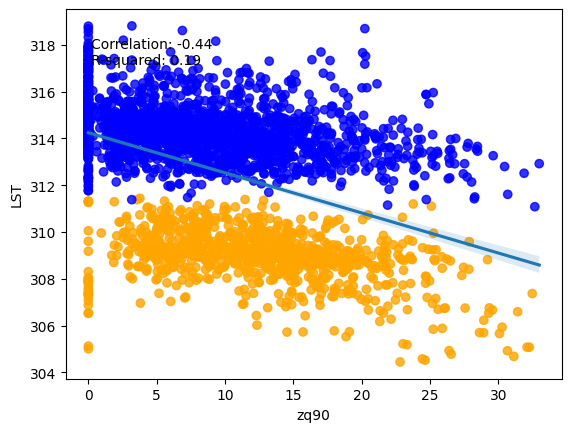

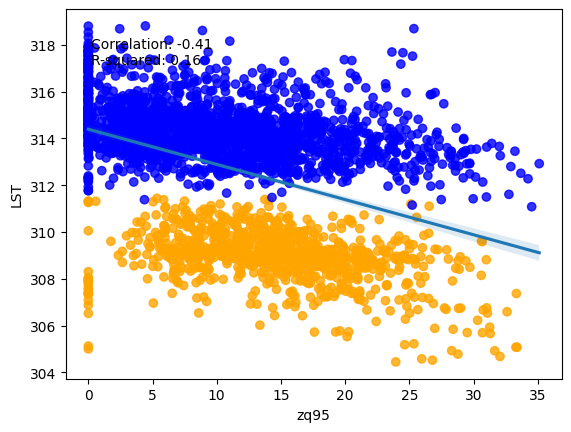

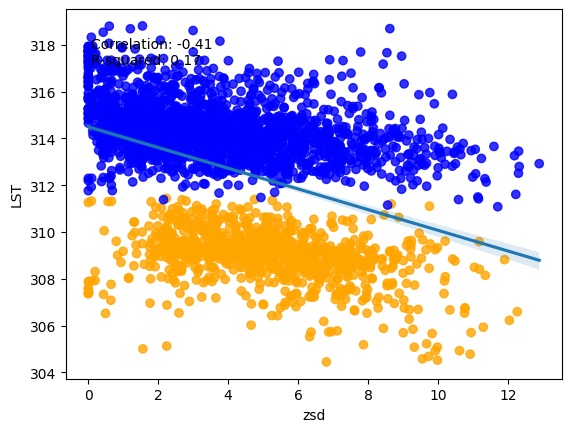

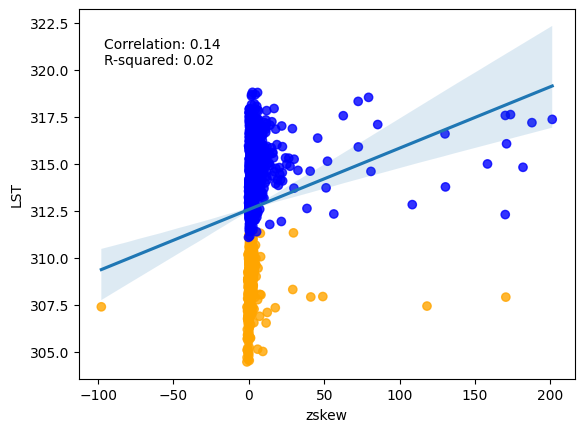

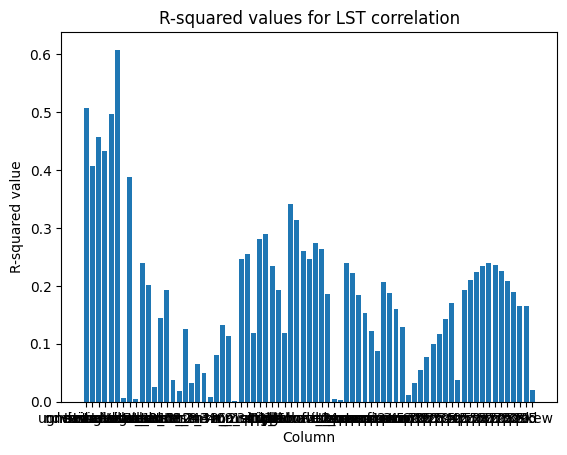

In [35]:
# Initialize an empty dictionary to store R-squared values
r2_values = {}

# Get the correlation between column 5 and all the other columns since column 6
corr = dfAll.iloc[:, 6:].corrwith(dfAll['LST'])

# Loop through each column and create a scatter plot with correlation line and R-squared value
for i in range(len(corr)):
    if not pd.isna(corr[i]):
        fig, ax = plt.subplots()
        category_colors = {'W': 'orange', 'E': 'blue'}
        colors = [category_colors[c] for c in dfAll['origin']]
        sns.regplot(x=dfAll.iloc[:, i+6], y=dfAll['LST'], ax=ax, scatter_kws={'color': colors})
        ax.set_xlabel(dfAll.columns[i+6])
        ax.set_ylabel('LST')
        corr_label = 'Correlation: {:.2f}'.format(corr[i])
        r2_label = 'R-squared: {:.2f}'.format(corr[i]**2)
        ax.annotate(corr_label + '\n' + r2_label, xy=(0.05, 0.85), xycoords='axes fraction')
        
        # Store the R-squared value in the dictionary with the column name as the key
        r2_values[dfAll.columns[i+6]] = corr[i]**2
        
        plt.show()
# create a bar chart from the r2_values dictionary
plt.bar(r2_values.keys(), r2_values.values())
# set the x-axis label
plt.xlabel('Column')
# set the y-axis label
plt.ylabel('R-squared value')
# set the chart title
plt.title('R-squared values for LST correlation')
# display the chart
plt.show()

In [36]:
columns_to_select = ['LST','origin','m0_6', 'm1_2', 'm1_8', 'm2_4', 'm3', 'm6','m9','m13','m18','m24','m32','m40']

# Create a sub dataframe with the selected columns
df_profile = dfAll.loc[:, columns_to_select]
df_profile['m_sum'] = df_profile.loc[:, 'm0_6':'m40'].sum(axis=1)
df_profile

,LST,origin,m0_6,m1_2,m1_8,m2_4,m3,m6,m9,m13,m18,m24,m32,m40,m_sum
0,306.895325,W,0.000067,0.000101,0.000651,0.001291,0.003951,0.079219,0.219304,0.283795,0.243416,0.000000,0.000000,0.0,0.831795
1,306.765076,W,0.000285,0.001345,0.005706,0.009619,0.009415,0.085548,0.117311,0.252160,0.105450,0.000217,0.000000,0.0,0.587056
2,306.276520,W,0.000013,0.000026,0.000065,0.000078,0.001134,0.012753,0.031935,0.097748,0.198743,0.214430,0.062449,0.0,0.619375
3,306.178711,W,0.000014,0.000028,0.000324,0.000493,0.000493,0.012504,0.034494,0.120623,0.345686,0.351988,0.010361,0.0,0.877009
4,306.668488,W,0.000000,0.000028,0.000028,0.000028,0.000097,0.021218,0.065211,0.138635,0.305227,0.230664,0.001362,0.0,0.762499
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1962,313.277588,E,0.000766,0.002248,0.004368,0.006718,0.014816,0.100925,0.013436,0.011188,0.000000,0.011342,0.000000,0.0,0.165807
1963,313.350525,E,0.000584,0.001531,0.001837,0.002226,0.006929,0.006623,0.005677,0.018423,0.000779,0.014694,0.000167,0.0,0.059470
1964,313.588745,E,0.007339,0.017083,0.010692,0.001202,0.000791,0.002278,0.000728,0.016197,0.001265,0.013919,0.000000,0.0,0.071494
1965,313.853790,E,0.002977,0.005739,0.010373,0.004757,0.013932,0.004542,0.011140,0.047812,0.049653,0.065918,0.004174,0.0,0.221015


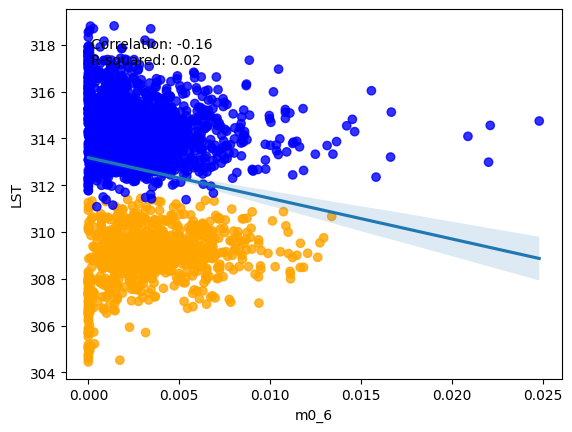

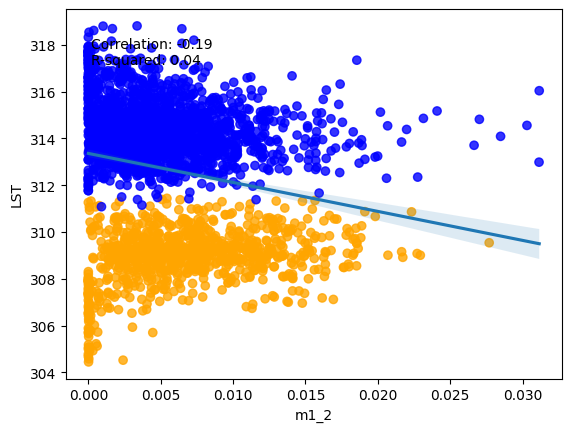

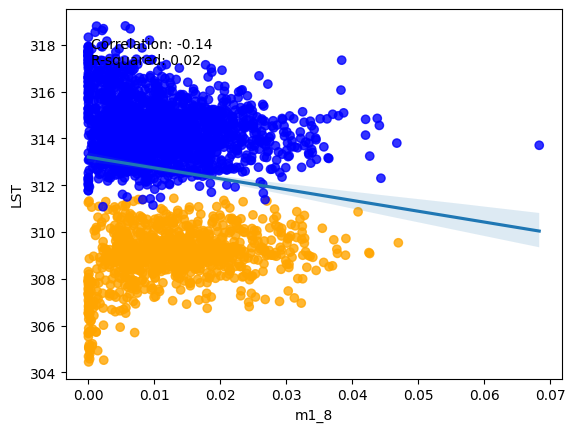

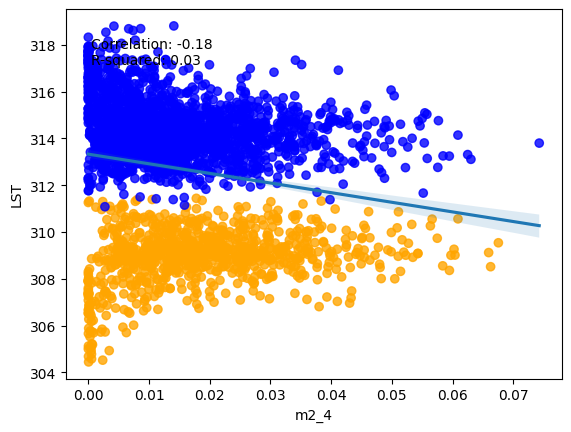

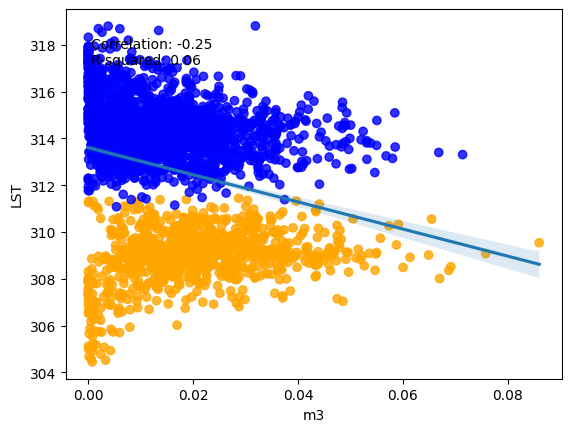

...

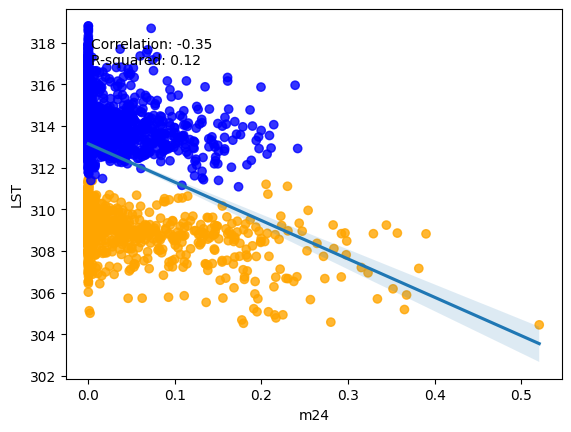

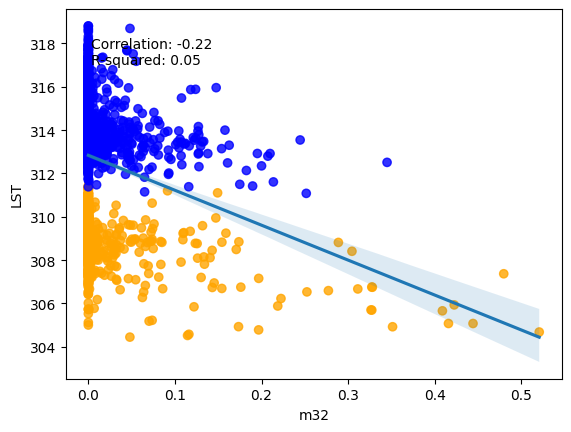

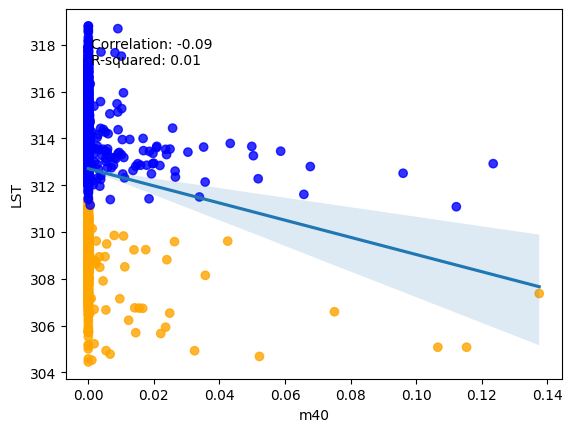

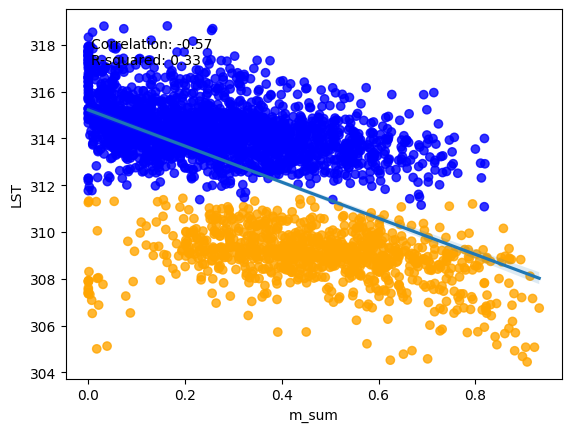

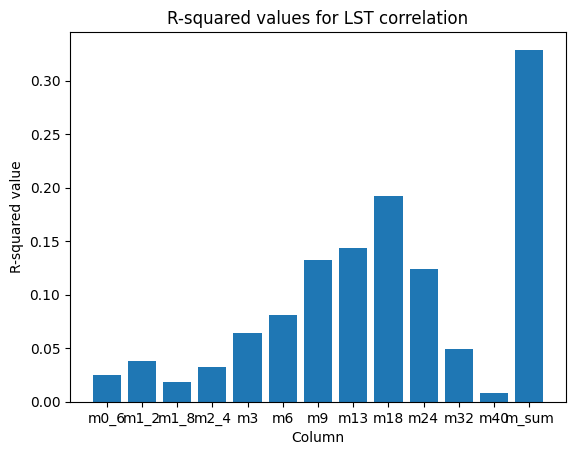

In [37]:
# Initialize an empty dictionary to store R-squared values
r2_values = {}

# Get the correlation between column 5 and all the other columns since column 6
corr = df_profile.iloc[:, 2:].corrwith(df_profile['LST'])

# Loop through each column and create a scatter plot with correlation line and R-squared value
for i in range(len(corr)):
    if not pd.isna(corr[i]):
        fig, ax = plt.subplots()
        category_colors = {'W': 'orange', 'E': 'blue'}
        colors = [category_colors[c] for c in df_profile['origin']]
        sns.regplot(x=df_profile.iloc[:, i+2], y=df_profile['LST'], ax=ax, scatter_kws={'color': colors})
        ax.set_xlabel(df_profile.columns[i+2])
        ax.set_ylabel('LST')
        corr_label = 'Correlation: {:.2f}'.format(corr[i])
        r2_label = 'R-squared: {:.2f}'.format(corr[i]**2)
        ax.annotate(corr_label + '\n' + r2_label, xy=(0.05, 0.85), xycoords='axes fraction')
        
        # Store the R-squared value in the dictionary with the column name as the key
        r2_values[df_profile.columns[i+2]] = corr[i]**2
        
        plt.show()
# create a bar chart from the r2_values dictionary
plt.bar(r2_values.keys(), r2_values.values())
# set the x-axis label
plt.xlabel('Column')
# set the y-axis label
plt.ylabel('R-squared value')
# set the chart title
plt.title('R-squared values for LST correlation')
# display the chart
plt.show()

In [38]:
columns_to_select = ['LST','origin','zq5','zq10', 'zq15', 'zq20', 'zq25', 'zq30', 'zq35','zq40','zq45','zq50','zq55','zq60','zq65','zq70','zq75','zq80','zq85','zq90','zq95']

# Create a sub dataframe with the selected columns
df_zq = dfAll.loc[:, columns_to_select]
df_zq

,LST,origin,zq5,zq10,zq15,zq20,zq25,zq30,zq35,zq40,zq45,zq50,zq55,zq60,zq65,zq70,zq75,zq80,zq85,zq90,zq95
0,306.895325,W,-0.001,-0.001,0.002,4.4900,5.92900,6.8473,7.44800,8.1270,8.74500,9.325000,10.022000,10.734000,11.339650,12.1057,12.899000,13.717000,14.32300,14.879000,15.456000
1,306.765076,W,-0.002,-0.002,-0.001,-0.0010,-0.00100,0.0010,0.00200,0.0020,3.62215,5.420000,6.593000,7.816000,9.155550,10.0089,10.821250,11.460600,12.24600,13.119000,14.354000
2,306.276520,W,-0.002,-0.002,-0.001,-0.0010,0.00100,0.0010,0.00200,6.9558,9.97700,11.817000,13.970000,15.083000,16.263901,17.5630,18.514000,19.490999,20.48600,22.149000,24.691700
3,306.178711,W,-0.001,0.001,7.507,10.1328,11.94000,13.1660,14.21865,15.0370,15.76800,16.403999,16.919001,17.500999,18.157000,18.7260,19.385000,20.016001,20.62715,21.320000,22.417000
4,306.668488,W,-0.002,-0.001,0.001,0.0020,5.35125,8.0680,10.04500,11.6470,12.73900,13.776500,14.703000,15.496000,16.234249,16.9585,17.709999,18.438000,19.48000,20.485001,21.694000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1962,313.277588,E,-0.002,-0.002,-0.002,-0.0020,-0.00200,-0.0010,-0.00100,-0.0010,-0.00100,-0.001000,0.001000,0.001000,0.001000,0.0010,0.002000,0.002000,2.48200,3.958000,4.998650
1963,313.350525,E,-0.002,-0.002,-0.002,-0.0020,-0.00200,-0.0010,-0.00100,-0.0010,-0.00100,-0.001000,-0.001000,0.001000,0.001000,0.0010,0.001000,0.002000,0.00200,0.002000,2.585350
1964,313.588745,E,-0.002,-0.002,-0.002,-0.0020,-0.00200,-0.0010,-0.00100,-0.0010,-0.00100,-0.001000,-0.001000,0.001000,0.001000,0.0010,0.001000,0.002000,0.00200,0.002000,1.030500
1965,313.853790,E,-0.002,-0.002,-0.002,-0.0020,-0.00100,-0.0010,-0.00100,-0.0010,-0.00100,0.001000,0.001000,0.001000,0.001000,0.0020,0.002000,2.118000,10.99525,14.638500,19.521999


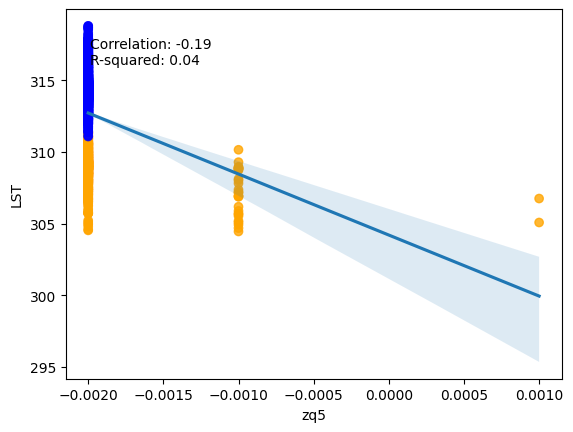

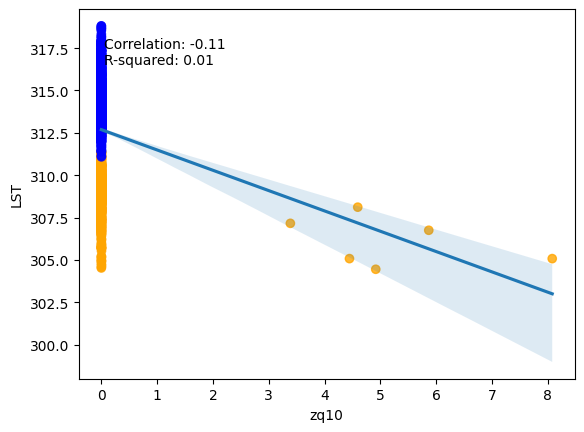

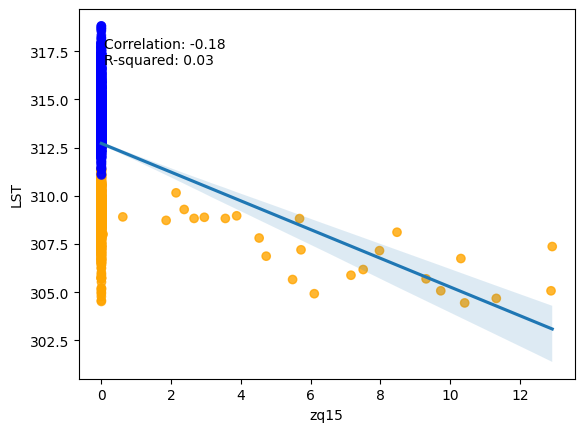

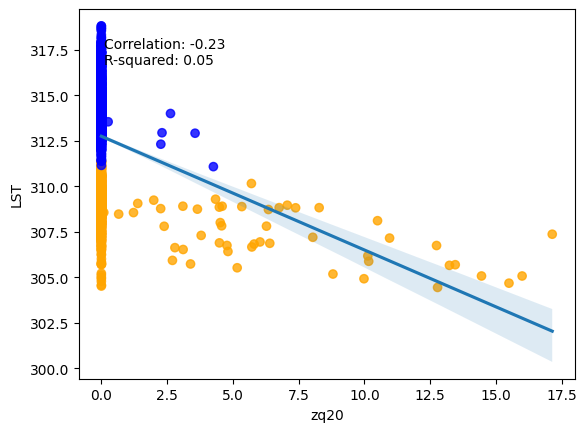

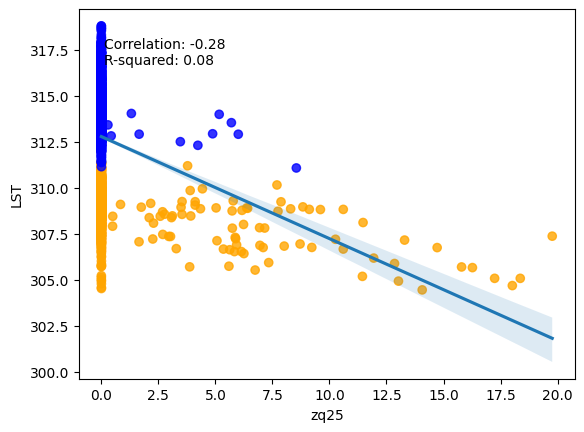

...

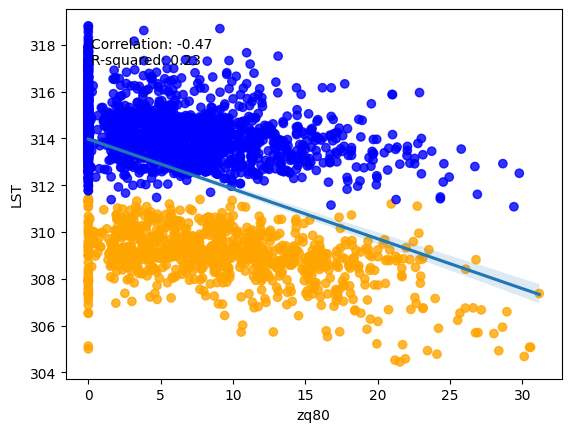

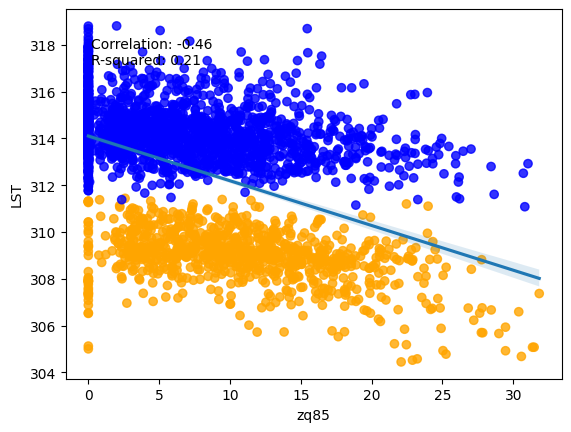

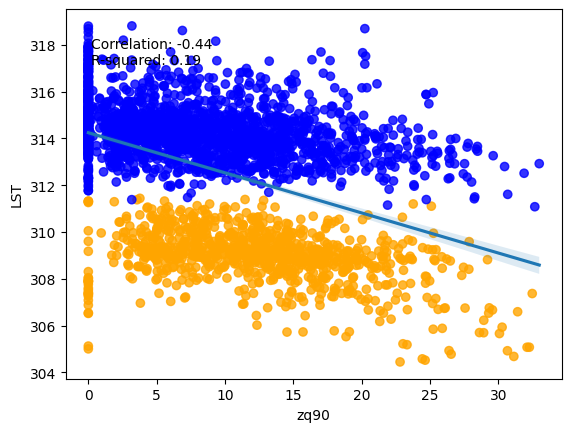

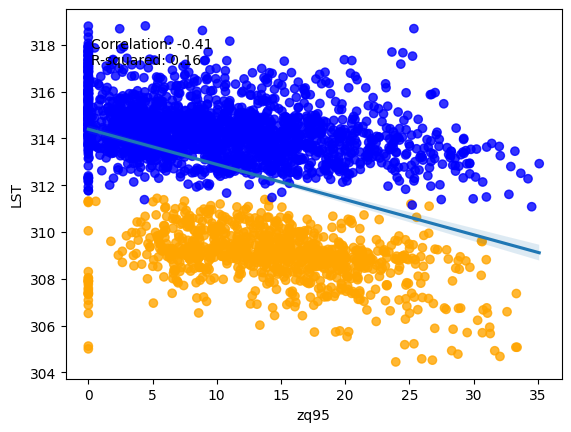

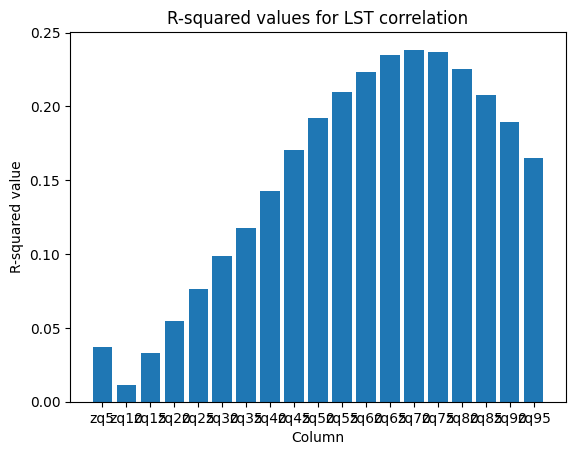

In [39]:
# Initialize an empty dictionary to store R-squared values
r2_values = {}

# Get the correlation between column 5 and all the other columns since column 6
corr = df_zq.iloc[:, 2:].corrwith(df_zq['LST'])

# Loop through each column and create a scatter plot with correlation line and R-squared value
for i in range(len(corr)):
    if not pd.isna(corr[i]):
        fig, ax = plt.subplots()
        category_colors = {'W': 'orange', 'E': 'blue'}
        colors = [category_colors[c] for c in df_zq['origin']]
        sns.regplot(x=df_zq.iloc[:, i+2], y=df_zq['LST'], ax=ax, scatter_kws={'color': colors})
        ax.set_xlabel(df_zq.columns[i+2])
        ax.set_ylabel('LST')
        corr_label = 'Correlation: {:.2f}'.format(corr[i])
        r2_label = 'R-squared: {:.2f}'.format(corr[i]**2)
        ax.annotate(corr_label + '\n' + r2_label, xy=(0.05, 0.85), xycoords='axes fraction')
        
        # Store the R-squared value in the dictionary with the column name as the key
        r2_values[df_zq.columns[i+2]] = corr[i]**2
        
        plt.show()
# create a bar chart from the r2_values dictionary
plt.bar(r2_values.keys(), r2_values.values())
# set the x-axis label
plt.xlabel('Column')
# set the y-axis label
plt.ylabel('R-squared value')
# set the chart title
plt.title('R-squared values for LST correlation')
# display the chart
plt.show()

In [40]:
columns_to_select = ['LST','origin','zpcum1','zpcum2', 'zpcum3', 'zpcum4', 'zpcum5', 'zpcum6', 'zpcum7','zpcum8','zpcum9']

# Create a sub dataframe with the selected columns
df_zpcum = dfAll.loc[:, columns_to_select]
df_zpcum

,LST,origin,zpcum1,zpcum2,zpcum3,zpcum4,zpcum5,zpcum6,zpcum7,zpcum8,zpcum9
0,306.895325,W,7.216960,8.377187,13.137122,22.410164,37.549492,52.457024,66.516312,78.582169,95.281410
1,306.765076,W,21.980213,25.972458,32.782867,43.002140,52.232037,66.884293,83.379967,93.783943,98.857010
2,306.276520,W,19.202929,20.790258,23.935963,33.230011,42.013115,57.593460,75.771095,88.527634,95.338501
3,306.178711,W,5.122216,6.171087,8.667308,15.340693,25.968336,44.446480,69.504875,91.002914,99.216782
4,306.668488,W,10.771832,11.843325,16.654472,23.621613,33.780464,48.890297,68.567390,84.833260,96.735115
...,...,...,...,...,...,...,...,...,...,...,...
1962,313.277588,E,68.633995,86.193954,94.515121,95.417099,97.690300,97.690300,97.690300,97.690300,99.165794
1963,313.350525,E,87.261696,90.267967,91.087852,92.161049,93.820824,96.313828,96.407143,96.487137,98.480202
1964,313.588745,E,91.757675,92.480812,92.532471,92.694809,93.218712,96.731110,96.738487,96.989372,98.922668
1965,313.853790,E,62.582901,65.283043,66.396255,69.653008,76.450737,82.147087,86.309807,92.254852,96.903130


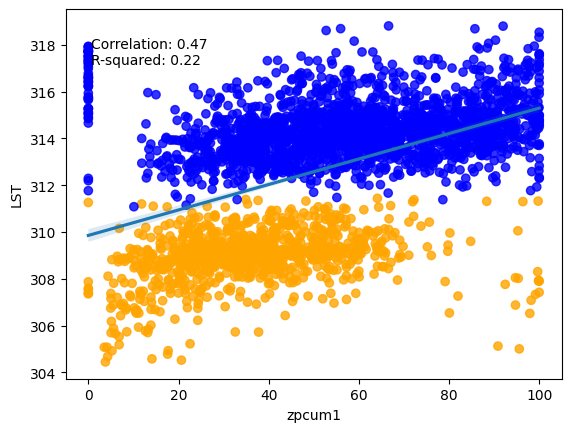

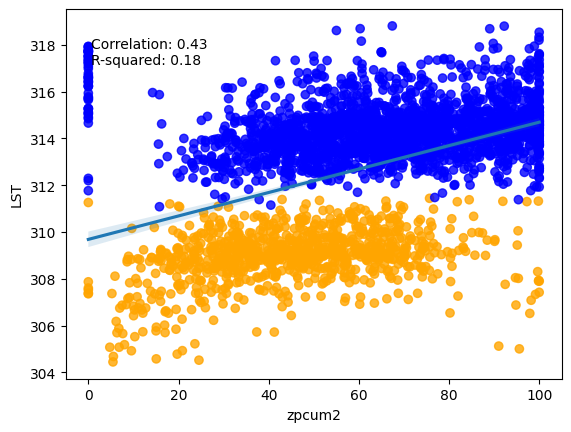

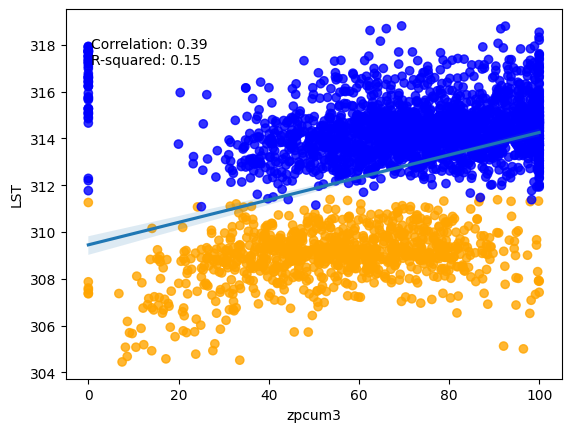

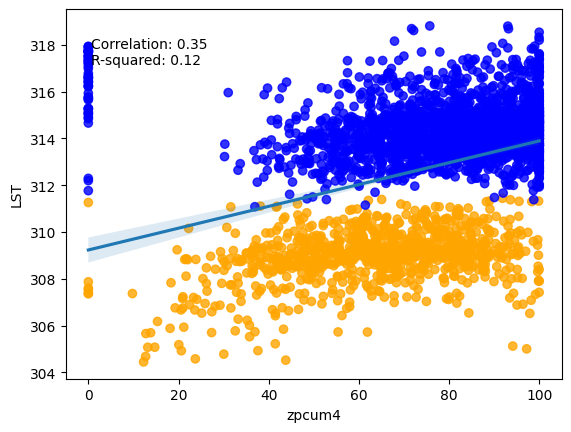

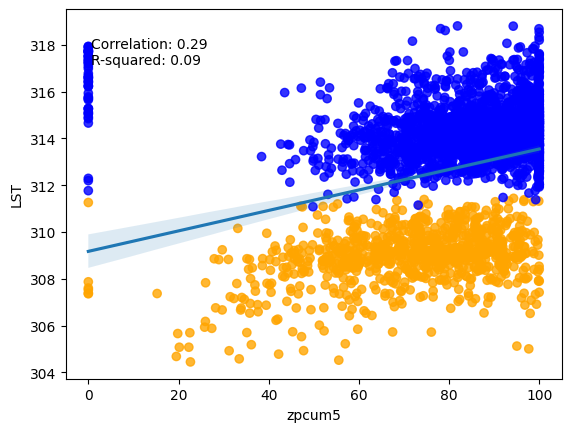

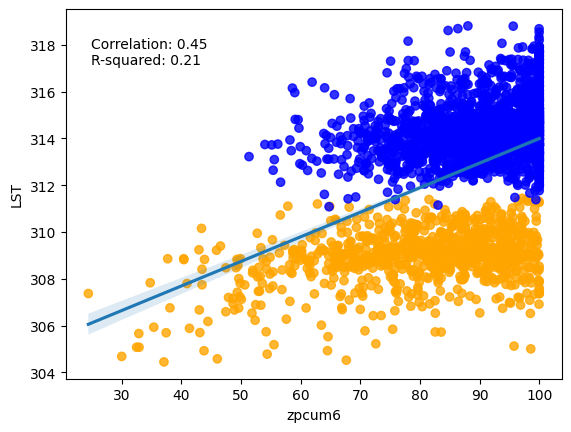

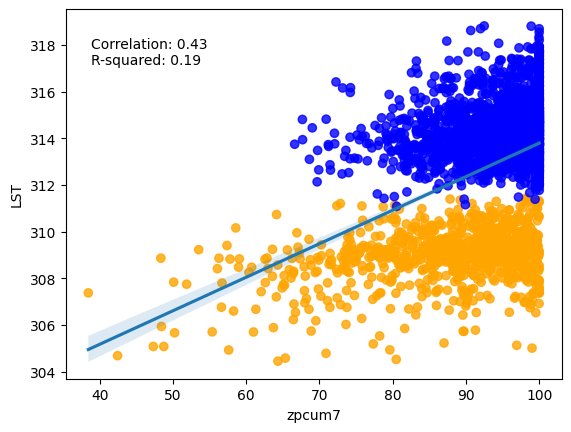

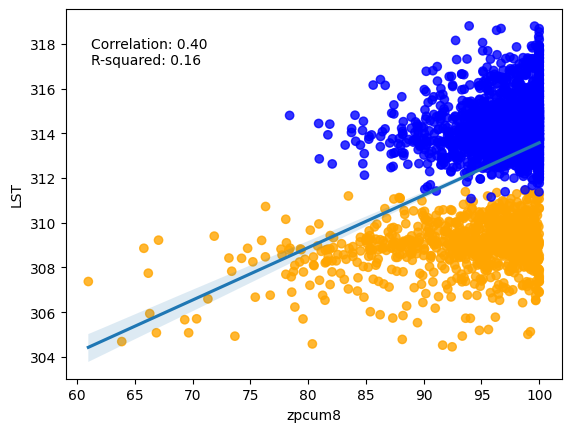

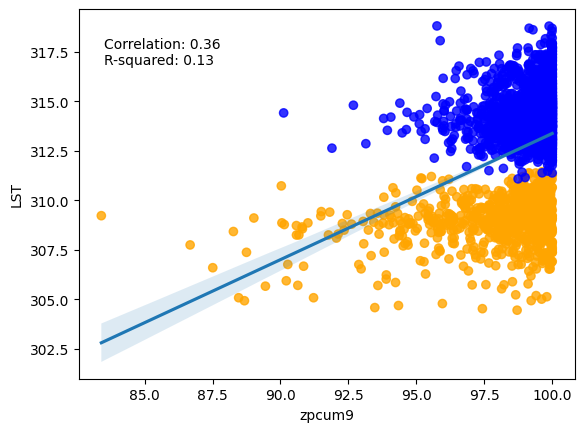

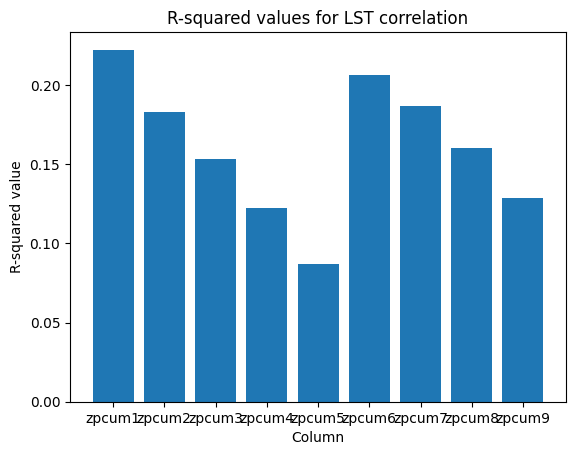

In [41]:
# Initialize an empty dictionary to store R-squared values
r2_values = {}

# Get the correlation between column 5 and all the other columns since column 6
corr = df_zpcum.iloc[:, 2:].corrwith(df_zpcum['LST'])

# Loop through each column and create a scatter plot with correlation line and R-squared value
for i in range(len(corr)):
    if not pd.isna(corr[i]):
        fig, ax = plt.subplots()
        category_colors = {'W': 'orange', 'E': 'blue'}
        colors = [category_colors[c] for c in df_zpcum['origin']]
        sns.regplot(x=df_zpcum.iloc[:, i+2], y=df_zpcum['LST'], ax=ax, scatter_kws={'color': colors})
        ax.set_xlabel(df_zpcum.columns[i+2])
        ax.set_ylabel('LST')
        corr_label = 'Correlation: {:.2f}'.format(corr[i])
        r2_label = 'R-squared: {:.2f}'.format(corr[i]**2)
        ax.annotate(corr_label + '\n' + r2_label, xy=(0.05, 0.85), xycoords='axes fraction')
        
        # Store the R-squared value in the dictionary with the column name as the key
        r2_values[df_zpcum.columns[i+2]] = corr[i]**2
        
        plt.show()
# create a bar chart from the r2_values dictionary
plt.bar(r2_values.keys(), r2_values.values())
# set the x-axis label
plt.xlabel('Column')
# set the y-axis label
plt.ylabel('R-squared value')
# set the chart title
plt.title('R-squared values for LST correlation')
# display the chart
plt.show()

In [42]:
columns_to_select = ['LST','origin','p1th', 'p2th', 'p3th', 'p4th','p5th']

# Create a sub dataframe with the selected columns
df_pth = dfAll.loc[:, columns_to_select]
df_pth

,LST,origin,p1th,p2th,p3th,p4th,p5th
0,306.895325,W,63.643608,26.541838,8.324914,1.429020,0.059496
1,306.765076,W,73.898216,19.285948,5.568688,1.184654,0.062493
2,306.276520,W,65.386574,21.745537,9.635271,2.990077,0.234720
3,306.178711,W,52.306175,30.702002,13.029321,3.665069,0.294615
4,306.668488,W,52.412251,29.793236,13.678681,3.785121,0.325154
...,...,...,...,...,...,...,...
1962,313.277588,E,90.617653,8.409114,0.937468,0.033207,0.002554
1963,313.350525,E,93.735741,5.724383,0.525964,0.013914,0.000000
1964,313.588745,E,95.033371,4.634463,0.319509,0.012654,0.000000
1965,313.853790,E,87.918121,10.047259,1.810593,0.214816,0.009206


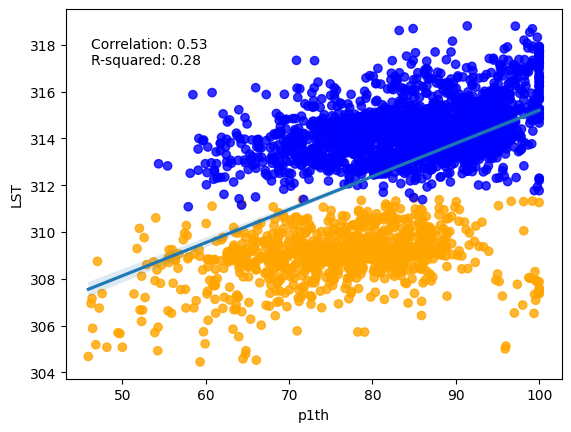

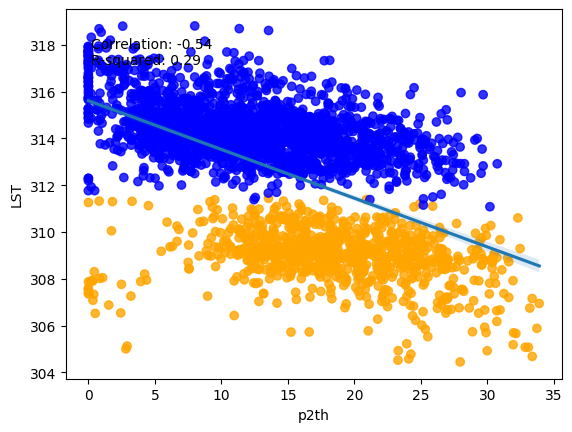

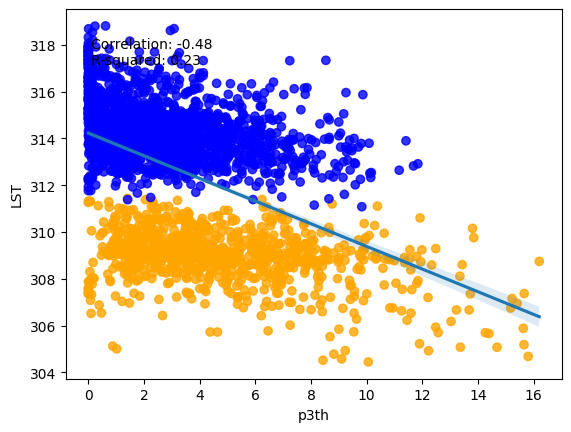

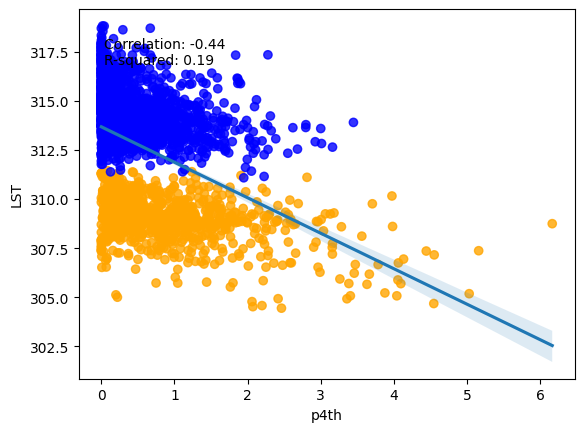

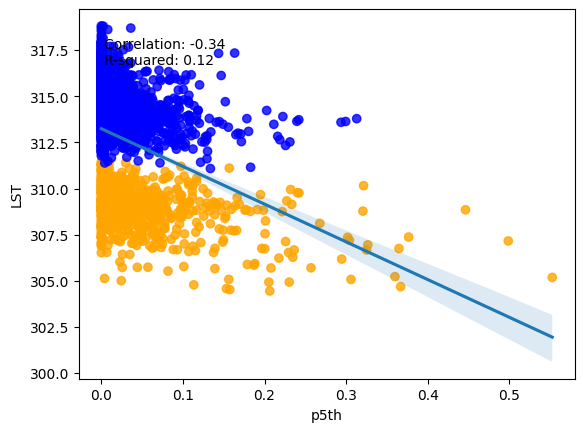

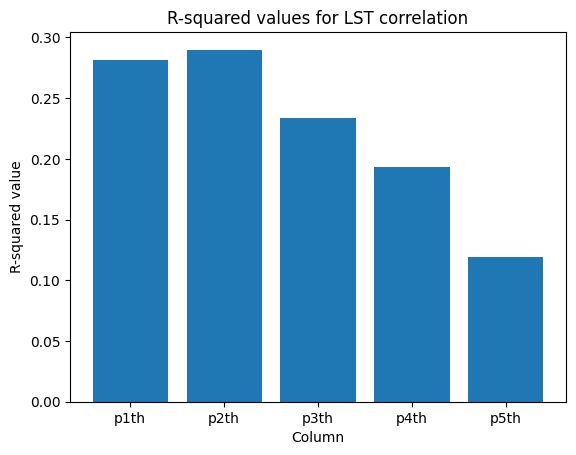

In [43]:
# Initialize an empty dictionary to store R-squared values
r2_values = {}

# Get the correlation between column 5 and all the other columns since column 6
corr = df_pth.iloc[:, 2:].corrwith(df_pth['LST'])

# Loop through each column and create a scatter plot with correlation line and R-squared value
for i in range(len(corr)):
    if not pd.isna(corr[i]):
        fig, ax = plt.subplots()
        category_colors = {'W': 'orange', 'E': 'blue'}
        colors = [category_colors[c] for c in df_pth['origin']]
        sns.regplot(x=df_pth.iloc[:, i+2], y=df_pth['LST'], ax=ax, scatter_kws={'color': colors})
        ax.set_xlabel(df_pth.columns[i+2])
        ax.set_ylabel('LST')
        corr_label = 'Correlation: {:.2f}'.format(corr[i])
        r2_label = 'R-squared: {:.2f}'.format(corr[i]**2)
        ax.annotate(corr_label + '\n' + r2_label, xy=(0.05, 0.85), xycoords='axes fraction')
        
        # Store the R-squared value in the dictionary with the column name as the key
        r2_values[df_pth.columns[i+2]] = corr[i]**2
        
        plt.show()
# create a bar chart from the r2_values dictionary
plt.bar(r2_values.keys(), r2_values.values())
# set the x-axis label
plt.xlabel('Column')
# set the y-axis label
plt.ylabel('R-squared value')
# set the chart title
plt.title('R-squared values for LST correlation')
# display the chart
plt.show()

In [44]:
# Define the dependent variable
y = dfAll['LST']

# Define the independent variables
x_cols = ['m0_6', 'm1_2', 'm1_8', 'm2_4', 'm3', 'm6','m9','m13','m18','m24','m32','m40']  # Replace with your list of column names
X = dfAll[x_cols]

# Fit the linear regression model
model = LinearRegression().fit(X, y)
# Print the coefficients
print('Coefficients:', model.coef_)
# Print the intercept
print('Intercept:', model.intercept_)
# Print the R-squared value
print('R-squared:', model.score(X, y))

Coefficients: [  56.02248    -192.59117      36.364586      8.8736725   -52.720627
   -0.75992584  -12.938258      0.22042465  -12.855057     -5.6633034
  -11.111832     11.801943  ]
Intercept: 315.58392
R-squared: 0.3762543206015816


In [45]:
# Define the dependent variable
y = dfAll['LST']

# Define the independent variables
x_cols = ['zq5','zq10', 'zq15', 'zq20', 'zq25', 'zq30', 'zq35','zq40','zq45','zq50','zq55','zq60','zq65','zq70','zq75','zq80','zq85','zq90','zq95']  # Replace with your list of column names
X = dfAll[x_cols]

# Fit the linear regression model
model = LinearRegression().fit(X, y)
# Print the coefficients
print('Coefficients:', model.coef_)
# Print the intercept
print('Intercept:', model.intercept_)
# Print the R-squared value
print('R-squared:', model.score(X, y))

Coefficients: [-4.9224344e+02 -3.6335424e-02  2.3337951e-01 -1.7139812e-01
  9.8747492e-02 -3.7240782e-01  3.5765395e-01  2.9802270e-02
 -2.2294709e-01  6.6472292e-02 -6.2142439e-02  4.4773661e-02
 -8.3387055e-02  6.5287836e-03 -1.2077055e-01 -4.5502845e-02
  8.8678420e-02 -6.7860603e-02 -1.8488225e-03]
Intercept: 312.8319
R-squared: 0.24908705107115425


In [46]:
# Define the dependent variable
y = dfAll['LST']

# Define the independent variables
x_cols = ['zpcum1','zpcum2','zpcum3','zpcum4','zpcum5','zpcum6','zpcum7','zpcum8','zpcum9']  # Replace with your list of column names
X = dfAll[x_cols]

# Fit the linear regression model
model = LinearRegression().fit(X, y)
# Print the coefficients
print('Coefficients:', model.coef_)
# Print the intercept
print('Intercept:', model.intercept_)
# Print the R-squared value
print('R-squared:', model.score(X, y))

Coefficients: [ 0.11247182 -0.10278696  0.04644812  0.02797181 -0.07946815  0.07475426
  0.02450267 -0.08540126  0.2942187 ]
Intercept: 284.4785
R-squared: 0.3273057257416666


In [47]:
# Define the dependent variable
y = dfAll['LST']

# Define the independent variables
x_cols = ['p1th','p2th','p3th','p4th','p5th']  # Replace with your list of column names
X = dfAll[x_cols]

# Fit the linear regression model
model = LinearRegression().fit(X, y)
# Print the coefficients
print('Coefficients:', model.coef_)
# Print the intercept
print('Intercept:', model.intercept_)
# Print the R-squared value
print('R-squared:', model.score(X, y))

Coefficients: [284.42896 284.0597  285.53552 280.49316 304.50995]
Intercept: -28126.828
R-squared: 0.3233246787673303
